<a href="https://colab.research.google.com/github/Slautin/2025_vae_dkl/blob/main/3_DKL_VAE_QM9_dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#VAE model: QM9 dataset

February 2025

Supporting codes for the manuscript: **Integrating Predictive and Generative Capabilities by Latent Space Design via the DKL-VAE model**

*Notebook 3 of 3*

This Notebook presents an analysis of the latent space structure learned by a DKL-VAE model trained on both the subset fo QM9 dataset.

* Author [Boris Slautin](https://scholar.google.com/citations?hl=ru&view_op=list_works&gmla=AH70aAU_JtxEIQgg_RTLPnUSZHKp1J1iDrJUxTZ7Dzw5p5jEtCEug5zMWLCh4A-pe5ekW_9a_aXHOSIjEp-2UT_kypL9DfD7GcD76qEpeOzSkAibBjmm_7RL&user=Y2AXABsAAAAJ)

* [Pyroved](https://pyroved.readthedocs.io/en/latest/) package by [Maxim Ziatdinov](https://scholar.google.com/citations?user=YnSdOoUAAAAJ&hl=en)

* DKL-VAE model by [Maxim Ziatdinov](https://scholar.google.com/citations?user=YnSdOoUAAAAJ&hl=en). Edited and optimized by [Utkarsh Pratiush](https://scholar.google.com/citations?user=BqhnGGAAAAAJ&hl=en) and [Boris Slautin](https://scholar.google.com/citations?hl=ru&view_op=list_works&gmla=AH70aAU_JtxEIQgg_RTLPnUSZHKp1J1iDrJUxTZ7Dzw5p5jEtCEug5zMWLCh4A-pe5ekW_9a_aXHOSIjEp-2UT_kypL9DfD7GcD76qEpeOzSkAibBjmm_7RL&user=Y2AXABsAAAAJ)

* Project lead and supervision by [Sergei V. Kalinin](https://scholar.google.com/citations?hl=en&user=-cuxoSQAAAAJ&view_op=list_works&sortby=pubdate)


 Molecules dataset import and analysis inspired by [Chemical_DKL_demo.ipynb](https://colab.research.google.com/github/SergeiVKalinin/Molecular_Exploration/blob/main/Chemical_DKL_demo.ipynb)


In [1]:
!pip install git+https://github.com/ziatdinovmax/pyroved.git;
!pip install rdkit-pypi
!pip install selfies --upgrade

  Cloning https://github.com/ziatdinovmax/pyroved.git to /tmp/pip-req-build-1qg4eyrb
  Running command git clone --filter=blob:none --quiet https://github.com/ziatdinovmax/pyroved.git /tmp/pip-req-build-1qg4eyrb
  Resolved https://github.com/ziatdinovmax/pyroved.git to commit 7807ffb1cb415b3cc76c1e02d52465a8ae0eeae4
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 756.0/756.0 kB 10.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 80.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 82.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 51.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 27.2 MB/s eta 0:00:00
 

In [2]:
import math
import numpy as np
import matplotlib.pyplot as plt
import cv2
import glob

from pyroved.models.base import baseVAE
from pyroved.utils import (set_deterministic_mode, init_dataloader, get_sampler,
                           generate_latent_grid, plot_img_grid, plot_spect_grid)

from pyroved.nets import fcEncoderNet, fcDecoderNet, sDecoderNet

from typing import Callable, Dict, Union, List, Tuple, Optional, Tuple, Type
import pyro
import pyro.distributions as dist
import pyro.optim as optim
import pyro.infer as infer

import torch
import torch.nn as nn

tt = torch.tensor

import pandas as pd
import rdkit
from rdkit import Chem
from rdkit.Chem import Descriptors
from rdkit.Chem import rdMolDescriptors
from rdkit.Chem import Draw

import selfies as sf


torch.manual_seed(42)
np.random.seed(42)

# Ensure deterministic behavior in CUDA
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False



# 1. VAE-DKL model

In [3]:
#@title Kernels

kernel_fn_type = Callable[[torch.Tensor, torch.Tensor, Dict[str, torch.Tensor], torch.Tensor],  torch.Tensor]

get_device = lambda: 'cuda:0' if torch.cuda.is_available() else 'cpu'

def _sqrt(x, eps=1e-12):
    return torch.sqrt(x + eps)


def add_jitter(x, jitter=1e-6):
    return x + jitter

def square_scaled_distance(X: torch.tensor, Z: torch.Tensor,
                           lengthscale: torch.Tensor = 1.,
                           **kwargs: str
                           ) -> torch.Tensor:

    device = kwargs.get("device", get_device())
    scaled_X = X / lengthscale.to(device)
    scaled_Z = Z / lengthscale.to(device)
    X2 = (scaled_X ** 2).sum(1, keepdims=True)
    Z2 = (scaled_Z ** 2).sum(1, keepdims=True)
    XZ = torch.matmul(scaled_X, scaled_Z.T)
    r2 = X2 - 2 * XZ + Z2.T
    return r2.clip(0)


def RBFKernel(X: torch.Tensor, Z: torch.Tensor,
              params: Dict[str, torch.Tensor],
              noise: int = 0, **kwargs: Union[float, str]
              ) -> torch.Tensor:

    device = kwargs.get("device", get_device())
    r2 = square_scaled_distance(X, Z, params["k_length"]).to(device)
    k = params["k_scale"].to(device) * torch.exp(-0.5 * r2)
    if X.shape == Z.shape:
        k += (add_jitter(noise, **kwargs).to(device)
        * torch.eye(X.shape[0]).to(device))
    return k


def Matern52Kernel(X: torch.Tensor, Z: torch.Tensor,
                   params: Dict[str, torch.Tensor],
                   noise: int = 0, **kwargs: Union[float, str]
                   ) -> torch.Tensor:

    device = kwargs.get("device", get_device())
    r2 = square_scaled_distance(X, Z, params["k_length"])
    r = _sqrt(r2)
    sqrt5_r = 5**0.5 * r
    k = params["k_scale"] * (1 + sqrt5_r + (5/3) * r2) * torch.exp(-sqrt5_r)
    if X.shape == Z.shape:
        k += (add_jitter(noise, **kwargs).to(device) * torch.eye(X.shape[0]).to(device)).to(device)
    return k


def get_kernel(kernel: Union[str, kernel_fn_type] = 'RBF'):
    kernel_book = {
        'RBF': RBFKernel,
        'Matern': Matern52Kernel,
    }
    if isinstance(kernel, str):
        try:
            kernel = kernel_book[kernel]
        except KeyError:
            print('Select one of the currently available kernels:',
                  *kernel_book.keys())
            raise
    return kernel



In [4]:
#@title VAE-DKL model

class dkiVAE(baseVAE):

    def __init__(self,
                 data_dim: Tuple[int],
                 latent_dim: int,
                 invariances: List[str] = None,
                 hidden_dim_e: List[int] = None,
                 hidden_dim_d: List[int] = None,
                 activation: str = "tanh",
                 sampler_d: str = "bernoulli",
                 sigmoid_d: bool = True,
                 kernel: kernel_fn_type = 'Matern',
                 latent_mean_fn: Optional[Callable[[torch.Tensor, Dict[str, torch.Tensor]], torch.Tensor]] = None,
                 latent_mean_fn_prior: Optional[Callable[[torch.Tensor], Dict[str, torch.Tensor]]] = None,
                 dkl_scale_factor: int = 1,
                 X: torch.Tensor = None,
                 y: torch.Tensor = None,
                 seed: int = 1,
                 rng_key = None,
                 **kwargs: Union[str, float]
                 ) -> None:

        args = (data_dim, invariances)
        super(dkiVAE, self).__init__(*args, **kwargs)
        pyro.clear_param_store()
        set_deterministic_mode(seed)

        self.data_dim = data_dim
        self.kernel = kernel
        self.dkl_scale = dkl_scale_factor
        self.latent_mean_fn = latent_mean_fn
        self.latent_mean_fn_prior = latent_mean_fn_prior
        self.rng_key = rng_key

        # Initialize z-Encoder neural network

        self.encoder_z = fcEncoderNet(
            data_dim, latent_dim+self.coord, 0,
            hidden_dim_e, activation, flat=False)           #added dropout

        # Initialize Decoder neural network
        dnet = sDecoderNet if 0 < self.coord < 5 else fcDecoderNet
        self.decoder = dnet(
            data_dim, latent_dim, 0, hidden_dim_d,
            activation, sigmoid_out=sigmoid_d, unflat=False)
        self.sampler_d = get_sampler(sampler_d, **kwargs)

        # Set latent dimensions
        self.z_dim = latent_dim + self.coord

        self.X_train = X
        self.y_train = y

        # Send model parameters to their appropriate devices
        self.to(self.device)

    def set_data(self, X: torch.Tensor, y: torch.Tensor):
        self.X_train = X
        self.y_train = y

    def model(self,
              x: torch.Tensor,
              **kwargs: float) -> None:
        """
        Defines the VAE model p(x|z)p(z)
        """
        # register PyTorch module `decoder` with Pyro
        pyro.module("decoder", self.decoder)
        # KLD scale factor (see e.g. https://openreview.net/pdf?id=Sy2fzU9gl)
        beta = kwargs.get("scale_factor", 1.)
        reshape_ = torch.prod(torch.tensor(x.shape[1:])).item()

        with pyro.plate("data", x.shape[0]):
            # setup hyperparameters for prior p(z)
            z_loc = x.new_zeros(torch.Size((x.shape[0], self.z_dim)))
            z_scale = x.new_ones(torch.Size((x.shape[0], self.z_dim)))
            # sample from prior (value will be sampled by guide when computing the ELBO)
            with pyro.poutine.scale(scale=beta):
                z = pyro.sample("latent", dist.Normal(z_loc, z_scale).to_event(1))

            if self.coord > 0:  # rotationally- and/or translationaly-invariant mode
                # Split latent variable into parts for rotation
                # and/or translation and image content
                phi, dx, sc, z = self.split_latent(z)
                if 't' in self.invariances:
                    dx = (dx * self.t_prior).unsqueeze(1)
                # transform coordinate grid
                grid = self.grid.expand(x.shape[0], *self.grid.shape)
                x_coord_prime = transform_coordinates(grid, phi, dx, sc)
            # decode the latent code z together with the transformed coordinates (if any)
            dec_args = (x_coord_prime, z) if self.coord else (z,)
            loc = self.decoder(*dec_args)
            # score against actual images ("binary cross-entropy loss")
            pyro.sample(
                "obs", self.sampler_d(loc.view(-1, reshape_)).to_event(1),
                obs=x.view(-1, reshape_))

    def guide(self,
               x: torch.Tensor,
               **kwargs: float) -> None:
        """
        Defines the guide q(z|x)
        """
        # register PyTorch module `encoder_z` with Pyro
        pyro.module("encoder_z", self.encoder_z)
        # KLD scale factor (see e.g. https://openreview.net/pdf?id=Sy2fzU9gl)
        beta = kwargs.get("scale_factor", 1.)

        with pyro.plate("data", x.shape[0]):
            # use the encoder to get the parameters used to define q(z|x)
            z_loc, z_scale = self.encoder_z(x)
            z_scale = torch.clamp(z_scale, min=1e-6)
            # sample the latent code z
            with pyro.poutine.scale(scale=beta):
                pyro.sample("latent", dist.Normal(z_loc, z_scale).to_event(1))

    def split_latent(self, z: torch.Tensor) -> Tuple[torch.Tensor]:
        """
        Split latent variable into parts associated with coordinate transformations
        (rotation and/or transaltion and/or scale) and image content.
        """
        return self._split_latent(z)

    def dkl(self, x: torch.Tensor, y: torch.Tensor, **kwargs) -> None:
        """Defines DKL model"""

        # Encode data using the current state of encoder_z
        z_loc, _ = self.encoder_z(x)


        # # Sample kernel parameters
        kernel_params = self._sample_kernel_params(self.z_dim - self.coord)

        # Sample noise
        noise = pyro.sample("noise", dist.HalfNormal(1.0))
        # GP's mean function
        f_loc = torch.zeros(z_loc.shape[0]).to(self.device)

        if self.latent_mean_fn is not None:
            args = [z_loc]
            if self.latent_mean_fn_prior is not None:
                args += [self.latent_mean_fn_prior()]
            f_loc += self.latent_mean_fn(*args).squeeze()

        # Compute kernel
        k = get_kernel(self.kernel)(
            z_loc, z_loc,
            kernel_params,
            noise,
            **kwargs
        )

        jitter_value = 1e-5
        k += torch.eye(k.shape[-1], device=k.device) * jitter_value

        # Sample y according to the standard Gaussian process formula
        with pyro.poutine.scale(scale=self.dkl_scale):
            pyro.sample(
                "y",
                dist.MultivariateNormal(loc=f_loc, covariance_matrix=k),
                obs=y,
            )

    def _sample_kernel_params(self, dim: int = None) -> Dict[str, torch.Tensor]:
        """
        Sample kernel parameters with weakly-informative log-normal priors
        """
        # with pyro.plate('k_param', dim):  # allows using ARD kernel for kernel_dim > 1
        #     length = pyro.sample("k_length", dist.LogNormal(0.0, 1.0))
        # scale = pyro.sample("k_scale", dist.LogNormal(0.0, 1.0))
        lb =tt([0.0])
        hb = tt([3.0])
        with pyro.plate('k_param', dim):  # allows using ARD kernel for kernel_dim > 1
            length = pyro.sample("k_length", dist.Uniform(0.1,5))
        scale = pyro.sample("k_scale", dist.Uniform(0.1,5))
        kernel_params = {
            "k_length": length.to(self.device), "k_scale": scale.to(self.device)}
        return kernel_params

    def encode(self,
               x_new: torch.Tensor,
               **kwargs: int) -> Tuple[torch.Tensor]:
        z = self._encode(x_new, **kwargs)
        z_loc, z_scale = z.split(self.z_dim, 1)
        return z_loc, z_scale

    def decode(self,
               z: torch.Tensor,
               **kwargs: int) -> torch.Tensor:
        z = z.to(self.device)
        loc = self._decode(z, **kwargs)
        return loc

    def get_mvn_posterior(self,
                          z_new: torch.Tensor,
                          noiseless: bool = True,
                          y_residual = None,
                          **kwargs
                          ) -> Tuple[torch.Tensor, torch.Tensor]:
        """
        Returns predictive mean and covariance at new latent points
        (mean and cov, where cov.diagonal() is 'uncertainty')
        given a single set of GP parameters
        """


        print(self.X_train.shape)
        z_new = z_new.to(self.device)
        z_train = self.encode(self.X_train)[0].to(self.device)
        y_train = self.y_train.to(self.device)

        if y_residual is None:
            y_residual = y_train.clone().to(self.device)

        kernel = get_kernel(self.kernel)
        params_store = pyro.get_param_store()
        self.param_store = params_store
        k_params = {k.split('.')[-1]: v.detach().to(self.device) for (k, v) in params_store.items()
                    if k != "weight" and k != "bias"}

        noise = k_params["noise"]
        self.k_params = k_params
        noise_p = noise * (1 - torch.tensor(noiseless).long()).to(self.device)

        # Appply latent mean function
        if self.latent_mean_fn is not None:
            args = [z_train, k_params] if self.latent_mean_fn_prior else [z_train]
            y_residual -= self.latent_mean_fn(*args).squeeze().to(self.device)


        # compute kernel matrices for train and test data
        k_pp = kernel(z_new, z_new, k_params, noise_p, **kwargs)
        k_pX = kernel(z_new, z_train, k_params, jitter=0.0)
        k_XX = kernel(z_train, z_train, k_params, noise, **kwargs)
        # compute the predictive covariance and mean
        K_xx_inv = torch.linalg.inv(k_XX)
        cov = k_pp - torch.matmul(k_pX, torch.matmul(K_xx_inv, k_pX.T))
        mean = torch.matmul(k_pX, torch.matmul(K_xx_inv, y_residual))

        # Apply latent mean function
        if self.latent_mean_fn is not None:
            args = [z_new, k_params] if self.latent_mean_fn_prior else [z_new]
            mean += self.latent_mean_fn(*args).squeeze()

        return mean.cpu(), cov.cpu()

    def dkl_predict(self,
                    X_new: torch.Tensor,
                    noiseless: bool = False,
                    **kwargs
                    ) -> Tuple[torch.Tensor, torch.Tensor]:
        """
        Makes a DKL prediction (input -> encode -> GP -> mean & uncertainty)
        """
        X_new = X_new.to(self.device)
        z_new, _ = self.encode(X_new)
        print(type(z_new), z_new.shape)
        mean, cov = self.get_mvn_posterior(z_new, noiseless, **kwargs)
        return mean, cov.diagonal()

    def vae_predict(self, data):
        v, U = self.encode(data)
        d = self.decode(v)
        probs = torch.softmax(d, dim=-1)
        predicted_indices = torch.argmax(probs.reshape(-1,*self.data_dim), dim=-1)
        one_hot_predictions = torch.nn.functional.one_hot(predicted_indices, num_classes=self.data_dim[-1])
        return one_hot_predictions

    def manifold2d(self, d: int,
                   plot: bool = True,
                   **kwargs: Union[str, int, float]) -> torch.Tensor:

        z_grid, (grid_x, grid_y) = generate_latent_grid(d, **kwargs)
        loc = self.decode(z_grid, **kwargs)
        if plot:
            if self.ndim == 2:
                loc = loc.reshape(loc.shape[0], *self.data_dim) if loc.ndim < 3 else loc
                plot_img_grid(
                    loc, d,
                    extent=[grid_x.min(), grid_x.max(), grid_y.min(), grid_y.max()],
                    **kwargs)
            elif self.ndim == 1:
                plot_spect_grid(loc, d, **kwargs)
        return loc

    def save_all_params(self, filepath: str) -> None:
        """
        Saves all parameters, weights, and training data of the VAE-DKL model.
        """
        # Save PyTorch state_dict for all model components
        state_dict = {
            "encoder_z": self.encoder_z.state_dict(),
            "decoder": self.decoder.state_dict(),
        }

        # Save Pyro parameter store
        pyro_params = pyro.get_param_store().get_state()

        # Save training data
        data_dict = {
            "X_train": self.X_train,
            "y_train": self.y_train,
        }

        # Combine and save
        save_dict = {
            "state_dict": state_dict,
            "pyro_params": pyro_params,
            "data_dict": data_dict,
        }

        torch.save(save_dict, filepath)
        print(f"All VAE-DKL parameters, weights, and training data saved to {filepath}")

    def load_all_params(self, filepath: str) -> None:
        """
        Loads all parameters, weights, and training data of the VAE-DKL model.
        """
        # Load the saved dictionary
        save_dict = torch.load(filepath, map_location=self.device)

        # Load PyTorch state_dict for all model components
        self.encoder_z.load_state_dict(save_dict["state_dict"]["encoder_z"])
        self.decoder.load_state_dict(save_dict["state_dict"]["decoder"])

        # Load Pyro parameter store
        pyro.get_param_store().set_state(save_dict["pyro_params"])

        # Load training data
        data_dict = save_dict["data_dict"]
        self.X_train = data_dict.get("X_train", None)
        self.y_train = data_dict.get("y_train", None)

        if self.X_train is not None:
          self.X_train = self.X_train.to(self.device)
        if self.y_train is not None:
          self.y_train = self.y_train.to(self.device)

        print(f"All VAE-DKL parameters, weights, and training data loaded from {filepath}")





In [5]:
#@title VAE-DKL Trainer

class JointModelTrainer:

    def __init__(self,
                model: Type[torch.nn.Module],
                lr1: float = 1e-4,
                lr2: float = 1e-2,
                optimizer2: Type[pyro.optim.PyroOptim] = None,
                loss_vae: Type[infer.ELBO] = None,
                loss_dkl: Type[infer.ELBO] = None,
                seed: int = 1,
                **kwargs: Union[str, float]
                ) -> None:

        pyro.clear_param_store()
        set_deterministic_mode(seed)
        self.device = kwargs.get(
            "device", 'cuda' if torch.cuda.is_available() else 'cpu')

        optimizer1 = optim.Adam({"lr": lr1})
        optimizer2 = optim.Adam({"lr": lr2})

        loss_vae = infer.Trace_ELBO()
        loss_dkl = infer.Trace_ELBO() if loss_dkl is None else loss2

        self.vae_svi = infer.SVI(
            model.model, model.guide, optimizer1, loss=loss_vae)
        self.dkl_svi = infer.SVI(
            model.dkl, infer.autoguide.AutoDelta(model.dkl),
            optimizer2, loss=loss_dkl)

        self.loss_history = {"training_loss": [],
                             "test_loss": [],
                             "vae_loss": [],
                             "dkl_loss": []}
        self.current_epoch = 0
        self.model = model

    def train(self,
              train_loader: Type[torch.utils.data.DataLoader],
              train_vae: bool = True,
              **kwargs: float) -> float:
        """
        Trains a single epoch
        """
        # initialize loss accumulator
        vae_epoch_loss = 0.
        if train_vae:
            # do a training epoch over each mini-batch returned by the data loader
            for data in train_loader:
                x, _ = data
                vae_loss = self.vae_svi.step(x.to(self.device), **kwargs)
                # accumulate loss
                vae_epoch_loss += vae_loss
        vae_epoch_loss /= len(train_loader.dataset)
        # Pass entire data through DKL (exact-gp regime)
        xf, yf = train_loader.dataset.tensors
        xf, yf = xf.to(self.device), yf.to(self.device)
        dkl_loss = self.dkl_svi.step(
            xf.to(self.device), yf.to(self.device), **kwargs)
        return vae_epoch_loss, dkl_loss, vae_epoch_loss + dkl_loss #+

    def step(self,
             train_loader: Type[torch.utils.data.DataLoader],
             train_vae: bool = True,
             **kwargs: float) -> None:
        """
        Single training and (optionally) test step
        Args:
            train_loader:
                Pytorch’s dataloader object with training data
            train_vae:
                Train variational autoencoder at this step
        """
        if self.model.X_train is None or self.model.y_train is None:
            self.model.set_data(*train_loader.dataset.tensors)
        vae_loss, dkl_loss, train_loss = self.train(train_loader, train_vae, **kwargs)
        self.loss_history["training_loss"].append(train_loss)
        self.loss_history["vae_loss"].append(vae_loss)
        self.loss_history["dkl_loss"].append(dkl_loss)
        self.current_epoch += 1

    def print_statistics(self) -> None:
        """
        Prints training and test (if any) losses for current epoch
        """
        e = self.current_epoch
        template = 'Epoch: {} Training loss: {:.4f} VAE loss: {:.4f} DKL loss: {:.4f}'
        print(template.format(e,
                              self.loss_history["training_loss"][-1],
                              self.loss_history["vae_loss"][-1],
                              self.loss_history["dkl_loss"][-1]))


# 2. Import and Preprocess the QM9 Dataset

In [6]:
#@title import and parcing
def parse_float(s: str) -> float:
    try:
        return float(s)
    except ValueError:
        base, power = s.split('*^')
        return float(base) * 10**float(power)

def parse_xyz(filename):
    """
    Parses QM9 specific xyz files.
    :param filename: str path to file
    :return:
    """
    num_atoms = 0
    scalar_properties = []
    atomic_symbols = []
    xyz = []
    charges = []
    harmonic_vibrational_frequencies = []
    smiles = ''
    inchi = ''
    with open(filename, 'r') as f:
        for line_num, line in enumerate(f):
            if line_num == 0:
                num_atoms = int(line)
            elif line_num == 1:
                scalar_properties = [float(i) for i in line.split()[2:]]
            elif 2 <= line_num <= 1 + num_atoms:
                atom_symbol, x, y, z, charge = line.split()
                atomic_symbols.append(atom_symbol)
                xyz.append([parse_float(x), parse_float(y), parse_float(z)])
                charges.append(parse_float(charge))
            elif line_num == num_atoms + 2:
                harmonic_vibrational_frequencies = [float(i) for i in line.split()]
            elif line_num == num_atoms + 3:
                smiles = line.split()[0]
            elif line_num == num_atoms + 4:
                inchi = line.split()[0]

    result = {
        'num_atoms': num_atoms,
        'atomic_symbols': atomic_symbols,
        'pos': torch.tensor(xyz),
        'charges': np.array(charges),
        'harmonic_oscillator_frequencies': harmonic_vibrational_frequencies,
        'smiles': smiles,
        'inchi': inchi
    }
    scalar_property_labels = ['A', 'B', 'C', 'mu', 'alpha', 'homo', 'lumo', 'gap', 'r2', 'zpve', 'u0', 'u', 'h', 'g', 'cv']
    scalar_properties = dict(zip(scalar_property_labels, scalar_properties))
    result.update(scalar_properties)
    return result

def create_uniform_subset(df, property_column, num_bins=10, samples_per_bin=50, borders=None):
    """
    Create a subset of the DataFrame with uniform distribution of a specific property.

    Parameters:
    - df (pd.DataFrame): The dataset.
    - property_column (str): The column name representing the property.
    - num_bins (int): The number of bins for discretizing the property range.
    - samples_per_bin (int): The number of samples to select from each bin.

    Returns:
    - pd.DataFrame: A subset of the DataFrame with a uniform distribution of the property.
    """
    # Determine bin edges based on the property range
    if borders == None:
      min_val, max_val = df[property_column].min(), df[property_column].max()
    else:
      min_val, max_val = borders[0], borders[1]
    bin_edges = np.linspace(min_val, max_val, num_bins + 1)

    # Initialize a list to store the subset
    subset = []

    # Bin the data and select samples
    for i in range(num_bins):
        # Find rows in the current bin
        bin_data = df[(df[property_column] >= bin_edges[i]) & (df[property_column] < bin_edges[i + 1])]

        # Shuffle the bin data
        bin_data = bin_data.sample(frac=1, random_state=42)  # Set random_state for reproducibility

        # Select the desired number of samples from the bin
        subset.append(bin_data.head(samples_per_bin))

    # Concatenate all bins to form the final subset
    uniform_subset = pd.concat(subset).reset_index(drop=True)
    return uniform_subset

Import data in SMILE format

In [7]:
!gdown https://drive.google.com/uc?id=1At3XHtaXXY3Qr4RIQ1Vua2_dRKoGyyEF

Downloading...
From (original): https://drive.google.com/uc?id=1At3XHtaXXY3Qr4RIQ1Vua2_dRKoGyyEF
From (redirected): https://drive.google.com/uc?id=1At3XHtaXXY3Qr4RIQ1Vua2_dRKoGyyEF&confirm=t&uuid=b3406175-0172-4fc9-8d21-7bd8ca7918b8
To: /content/dsgdb9nsd.xyz.tar.bz2
100% 86.1M/86.1M [00:00<00:00, 154MB/s]


In [8]:
!mkdir /content/Molecules;
!tar -C Molecules -xvf /content/dsgdb9nsd.xyz.tar.bz2;

Streaming output truncated to the last 5000 lines.
dsgdb9nsd_128886.xyz
dsgdb9nsd_128887.xyz
dsgdb9nsd_128888.xyz
dsgdb9nsd_128889.xyz
dsgdb9nsd_128890.xyz
dsgdb9nsd_128891.xyz
dsgdb9nsd_128892.xyz
dsgdb9nsd_128893.xyz
dsgdb9nsd_128894.xyz
dsgdb9nsd_128895.xyz
dsgdb9nsd_128896.xyz
dsgdb9nsd_128897.xyz
dsgdb9nsd_128898.xyz
dsgdb9nsd_128899.xyz
dsgdb9nsd_128900.xyz
dsgdb9nsd_128901.xyz
dsgdb9nsd_128902.xyz
dsgdb9nsd_128903.xyz
dsgdb9nsd_128904.xyz
dsgdb9nsd_128905.xyz
dsgdb9nsd_128906.xyz
dsgdb9nsd_128907.xyz
dsgdb9nsd_128908.xyz
dsgdb9nsd_128909.xyz
dsgdb9nsd_128910.xyz
dsgdb9nsd_128911.xyz
dsgdb9nsd_128912.xyz
dsgdb9nsd_128913.xyz
dsgdb9nsd_128914.xyz
dsgdb9nsd_128915.xyz
dsgdb9nsd_128916.xyz
dsgdb9nsd_128917.xyz
dsgdb9nsd_128918.xyz
dsgdb9nsd_128919.xyz
dsgdb9nsd_128920.xyz
dsgdb9nsd_128921.xyz
dsgdb9nsd_128922.xyz
dsgdb9nsd_128923.xyz
dsgdb9nsd_128924.xyz
dsgdb9nsd_128925.xyz
dsgdb9nsd_128926.xyz
dsgdb9nsd_128927.xyz
dsgdb9nsd_128928.xyz
dsgdb9nsd_128929.xyz
dsgdb9nsd_128930.xyz
dsgd

In [9]:
number_of_molecules = 130000


smiles = []
enthalpy = []
u0 = []
u = []
g = []
alpha = []
r2 = []
mu = []

#may need to change the path
filenames = glob.glob('/content/Molecules/*.xyz')

#may need to go through the full range
for fid in range(number_of_molecules):
    x = parse_xyz(filenames[fid])

    smiles_loc = x['smiles']
    enthalpy_loc = x['h']
    dipole_moment = x['mu']
    homo_loc = x['homo']
    lumo_loc = x['lumo']
    gap_loc = x['gap']
    zpve_loc = x['zpve']
    u0_loc = x['u0']
    u_loc = x['u']
    g_loc = x['g']
    alpha_loc = x['alpha']
    r2_loc = x['r2']

    smiles.append(smiles_loc)
    mu.append(dipole_moment)
    enthalpy.append(enthalpy_loc)
    u0.append(u0_loc)
    u.append(u_loc)
    g.append(g_loc)
    alpha.append(alpha_loc)
    r2.append(r2_loc)

In [10]:
df = pd.DataFrame({'smiles': smiles, 'enthalpy': enthalpy})

df= create_uniform_subset(df, 'enthalpy', num_bins=50, samples_per_bin=400, borders = [-500,-200] )

13109


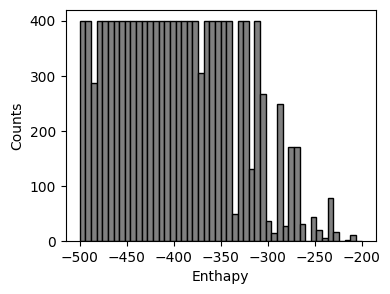

In [11]:
fig = plt.figure(figsize=(4,3))
_ = plt.hist(df['enthalpy'].values, bins=50, range=(-500,-200), edgecolor='black', color='grey')
plt.xlabel('Enthapy')
plt.ylabel('Counts')

print(len(df['enthalpy'].values))

**Convert to SELFIES**


The SELFIES have some limitations on acceptable bonding. So we refine the data set to remove the molecules that do not fit into supported semantic constraints.

In [12]:
selfies_dataset = []
error_smiles = []

smiles = df['smiles'].values

for i in range(len(smiles)):
    try:
      local_sf = sf.encoder(smiles[i])
      selfies_dataset.append(local_sf)
    except Exception as e:
        print(f"Error encoding SMILES at index {i}: {e}")
        error_smiles.append(smiles[i])  # Store the SMILES string that caused the error
        continue  # Skip to the next iteration

Error encoding SMILES at index 417: input violates the currently-set semantic constraints
	SMILES: CC1=NC(=CO1)N(=O)=O
	Errors:
	[N with 5 bond(s) - a max. of 3 bond(s) was specified]

Error encoding SMILES at index 424: input violates the currently-set semantic constraints
	SMILES: CC1=NC=C(O1)N(=O)=O
	Errors:
	[N with 5 bond(s) - a max. of 3 bond(s) was specified]

Error encoding SMILES at index 440: input violates the currently-set semantic constraints
	SMILES: CC1=CC(=NO1)N(=O)=O
	Errors:
	[N with 5 bond(s) - a max. of 3 bond(s) was specified]

Error encoding SMILES at index 511: input violates the currently-set semantic constraints
	SMILES: CC1=C(ON=C1)N(=O)=O
	Errors:
	[N with 5 bond(s) - a max. of 3 bond(s) was specified]

Error encoding SMILES at index 547: input violates the currently-set semantic constraints
	SMILES: NC1=CC(=CO1)N(=O)=O
	Errors:
	[N with 5 bond(s) - a max. of 3 bond(s) was specified]

Error encoding SMILES at index 559: input violates the currently-set semant

In [13]:
#error smile set
error_smiles_set = set(error_smiles)
print(error_smiles_set)

#remove from dataframe
df_filtered = df[~df['smiles'].isin(error_smiles_set)]
df_filtered.shape

df_filtered = df_filtered.sample(frac=1).reset_index(drop=True)

{'NC1=COC(=C1)N(=O)=O', 'NC1=NNC=C1N(=O)=O', 'O=N(=O)C1=NC=NO1', 'CC1=C(N=CO1)N(=O)=O', 'CC1=C(OC=N1)N(=O)=O', 'CN1C=C(N=N1)N(=O)=O', 'CC1=NC=C(O1)N(=O)=O', 'CC1=C(C=NN1)N(=O)=O', 'CC1=NNC=C1N(=O)=O', 'CC1=NC(=CO1)N(=O)=O', 'CC1=CON=C1N(=O)=O', 'CC1=C(N=CN1)N(=O)=O', 'NC1=CNC(=N1)N(=O)=O', 'O=N(=O)C1=NC=CN=N1', 'CC1=CC(=NO1)N(=O)=O', 'CN1N=CC(=N1)N(=O)=O', 'OC1=CNC(=C1)N(=O)=O', 'O=N(=O)C1=CN=CC=N1', 'CC1=C(NN=C1)N(=O)=O', 'O=N(=O)C1=CN=NC=N1', 'NC1=NC(=CN1)N(=O)=O', 'NC1=CNC(=C1)N(=O)=O', 'NC1=C(NC=N1)N(=O)=O', 'O=N(=O)C1=CN=CN=N1', 'O=N(=O)C1=CN=CN=C1', 'NC1=C(C=NN1)N(=O)=O', '[NH2+]=C1NC=C([N-]1)N(=O)=O', 'O=N(=O)C1=CON=N1', 'CN1C=NC(=C1)N(=O)=O', 'CN1C=C(C=N1)N(=O)=O', 'O=N(=O)C1=CN=NO1', 'NC1=C(C=CN1)N(=O)=O', 'NC1=NNC(=C1)N(=O)=O', 'NC1=CC(=CN1)N(=O)=O', 'CN1C=CN=C1N(=O)=O', 'O=N(=O)C1=CC=CN1', 'CC1=C(ON=C1)N(=O)=O', 'CN1N=NC=C1N(=O)=O', 'NC1=C(N=CN1)N(=O)=O', 'CN1C=NC(=N1)N(=O)=O', 'CC1=NNN=C1N(=O)=O', 'NC1=C(NN=C1)N(=O)=O', 'CN1N=CN=C1N(=O)=O', 'CC1=NOC(=C1)N(=O)=O', 'CC1=C(C=C

In [14]:
smiles = df_filtered['smiles'].values

selfies_dataset = []
error_smiles = []

for i in range(len(smiles)):
    try:
        local_sf = sf.encoder(smiles[i])
        selfies_dataset.append(local_sf)
    except Exception as e:
        print(f"Error encoding SMILES at index {i}: {e}")
        error_smiles.append(smiles[i])  # Store the SMILES string that caused the error
        continue  # Skip to the next iteration

**One hot encoding**

In [15]:
#for producing corresponding one-hot vectors
alphabet = sf.get_alphabet_from_selfies(selfies_dataset)
alphabet.add("[nop]")  # [nop] is a special padding symbol
alphabet = list(sorted(alphabet))

pad_to_len = max(sf.len_selfies(s) for s in selfies_dataset)
symbol_to_idx = {s: i for i, s in enumerate(alphabet)}

labels = []
one_hot_vectors = []
for i in range(len(selfies_dataset)):

  label, one_hot = sf.selfies_to_encoding(selfies=selfies_dataset[i], vocab_stoi=symbol_to_idx,
                                          pad_to_len=pad_to_len, enc_type="both")
  labels.append(label)
  one_hot_vectors.append(one_hot)

mol_all = tt(np.array(one_hot_vectors)).to(dtype=torch.int32)

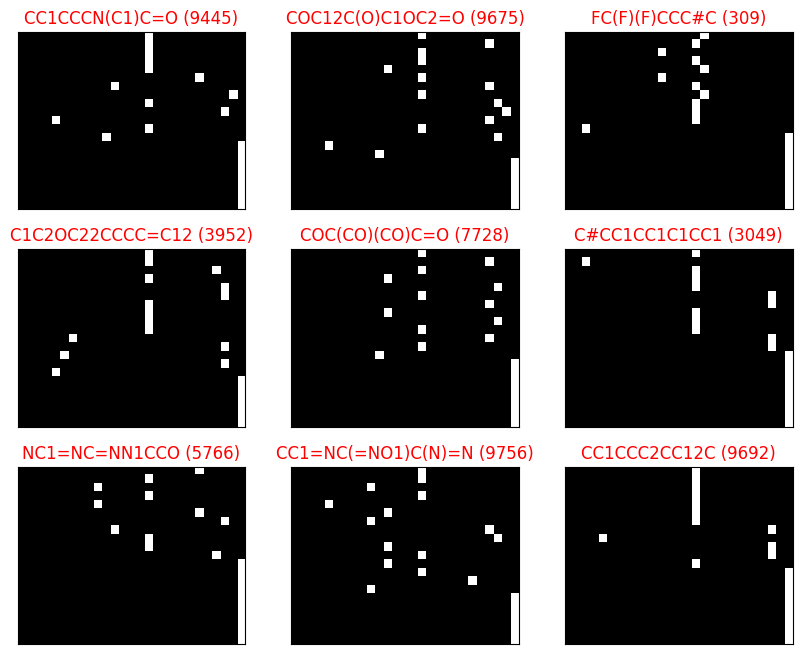

In [16]:
indd = np.random.randint(len(one_hot_vectors), size=9)

fig, ax = plt.subplots(3,3, figsize = (10, 8))

for i,ax_ in enumerate(ax.flatten()):
  ax_.imshow(one_hot_vectors[indd[i]], cmap='gray')
  ax_.tick_params(left=False,
                  bottom=False,
                  labelleft=False,
                  labelbottom=False)
  ax_.set_title(f"{df_filtered['smiles'][indd[i]]} ({indd[i]})", c='red')

In [17]:
#@title functions for saving data

def convert_to_supported_dtype(arr):
    # Check if array has an object dtype
    if arr.dtype == np.dtype('O'):
        # Attempt conversion to a compatible type (if possible)
        try:
            return arr.astype(np.float64)  # Change to a compatible type (e.g., float)
        except ValueError:
            raise ValueError(f"Cannot convert array '{arr}' to a supported dtype.")
    return arr

def save_dict_to_hdf5(file_path, data_dict):
    def save_data(group, data):
        for key, value in data.items():
            if isinstance(value, dict):
                subgroup = group.create_group(key)
                save_data(subgroup, value)
            elif isinstance(value, np.ndarray):
                # Check and convert object dtype arrays if needed
                value = convert_to_supported_dtype(value)
                group.create_dataset(key, data=value)
            else:
                group.create_dataset(key, data=value)
    with h5py.File(file_path, 'w') as f:
        save_data(f, data_dict)

def load_hdf5_to_dict(file_path):
    def load_data(group):
        data = {}
        for key, item in group.items():
            if isinstance(item, h5py.Group):
                data[key] = load_data(item)
            else:
                data[key] = np.array(item)
        return data

    with h5py.File(file_path, 'r') as f:
        data_dict = load_data(f)

    return data_dict

In [18]:
data_dim = mol_all.shape[-2:]
targets3 = df_filtered['enthalpy'].values

torch_mol_all = mol_all.reshape(-1,data_dim[0]*data_dim[1]).to(dtype=torch.float32)
print(data_dim)

torch.Size([21, 27])


In [19]:
mol_all.shape

torch.Size([13059, 21, 27])

# Angles by part

In [20]:
threshold = -400
threshold1 = -350
mol_train = mol_all[(targets3 < threshold) | (targets3 > threshold1)]
targets3_train = targets3[(targets3 < threshold) | (targets3 > threshold1)]

Text(0, 0.5, 'Counts')

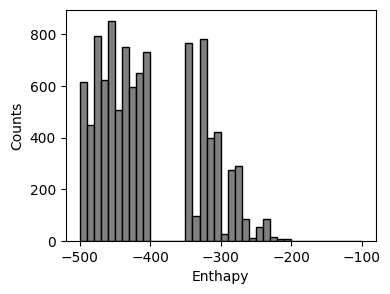

In [21]:
fig = plt.figure(figsize=(4,3))
_ = plt.hist(targets3_train, bins=40, range=(-500,-100), edgecolor='black', color='grey')
plt.xlabel('Enthapy')
plt.ylabel('Counts')

In [22]:
mol_test = mol_all[(targets3 > threshold) & (targets3 < threshold1)]
targets3_test = targets3[(targets3 > threshold) & (targets3 < threshold1)]

In [63]:
print(f'Length of train dataset: {len(targets3_train)}')
print(f'Length of test dataset: {len(targets3_test)}')

Length of train dataset: 9887
Length of test dataset: 3172


In [64]:
data_dim = mol_train.shape[-2:]


torch_mol_train = mol_train.reshape(-1,data_dim[0]*data_dim[1]).to(dtype=torch.float32)
torch_mol_test = mol_test.reshape(-1,data_dim[0]*data_dim[1]).to(dtype=torch.float32)

model = dkiVAE(data_dim=data_dim, latent_dim=17, dkl_scale_factor=1e-2,
               hidden_dim_d=[256],
               hidden_dim_e=[256],
               seed=40)

dataloader = init_dataloader(torch_mol_train, tt(targets3_train).to(dtype=torch.float32), batch_size=512)

In [65]:
trainer = JointModelTrainer(model, lr1=1e-3, seed=40)

Epoch: 1 Training loss: 167045.4393 VAE loss: 270.7087 DKL loss: 166774.7307
Epoch: 2 Training loss: 74576.9880 VAE loss: 77.3749 DKL loss: 74499.6131
Epoch: 3 Training loss: 42545.7593 VAE loss: 55.9830 DKL loss: 42489.7763
Epoch: 4 Training loss: 27711.9311 VAE loss: 51.1347 DKL loss: 27660.7964
Epoch: 5 Training loss: 20990.3688 VAE loss: 49.1778 DKL loss: 20941.1911
Epoch: 6 Training loss: 19888.1693 VAE loss: 48.0938 DKL loss: 19840.0755
Epoch: 7 Training loss: 19241.3369 VAE loss: 47.3675 DKL loss: 19193.9694
Epoch: 8 Training loss: 17084.2329 VAE loss: 46.8464 DKL loss: 17037.3865
Epoch: 9 Training loss: 17132.5055 VAE loss: 46.4073 DKL loss: 17086.0983
Epoch: 10 Training loss: 14739.1136 VAE loss: 46.0322 DKL loss: 14693.0814
Epoch: 11 Training loss: 13236.8270 VAE loss: 45.9580 DKL loss: 13190.8690
Epoch: 12 Training loss: 10833.3485 VAE loss: 45.6452 DKL loss: 10787.7033
Epoch: 13 Training loss: 10224.8629 VAE loss: 45.4974 DKL loss: 10179.3655
Epoch: 14 Training loss: 9837.8

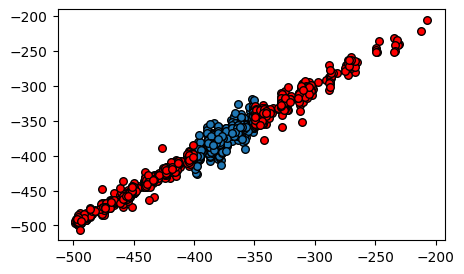

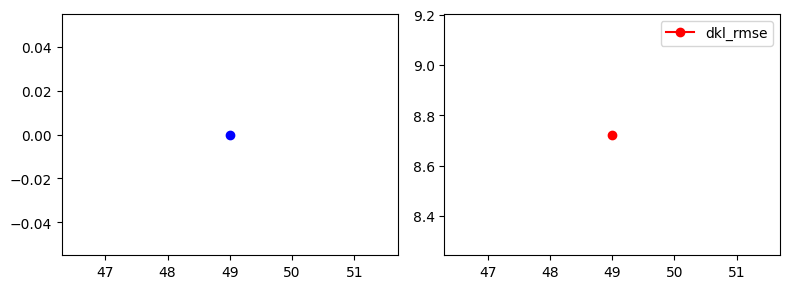

Epoch: 51 Training loss: 4459.6504 VAE loss: 36.8391 DKL loss: 4422.8114
Epoch: 52 Training loss: 4458.2951 VAE loss: 36.6780 DKL loss: 4421.6170
Epoch: 53 Training loss: 4443.9875 VAE loss: 36.4257 DKL loss: 4407.5619
Epoch: 54 Training loss: 4434.4240 VAE loss: 36.2722 DKL loss: 4398.1517
Epoch: 55 Training loss: 4410.5491 VAE loss: 36.0962 DKL loss: 4374.4530
Epoch: 56 Training loss: 4393.0175 VAE loss: 35.9112 DKL loss: 4357.1063
Epoch: 57 Training loss: 4381.5544 VAE loss: 35.7866 DKL loss: 4345.7678
Epoch: 58 Training loss: 4378.2614 VAE loss: 35.6343 DKL loss: 4342.6271
Epoch: 59 Training loss: 4374.7420 VAE loss: 35.4851 DKL loss: 4339.2569
Epoch: 60 Training loss: 4368.4185 VAE loss: 35.3658 DKL loss: 4333.0527
Epoch: 61 Training loss: 4370.8057 VAE loss: 35.2096 DKL loss: 4335.5961
Epoch: 62 Training loss: 4377.8358 VAE loss: 35.0709 DKL loss: 4342.7649
Epoch: 63 Training loss: 4387.3446 VAE loss: 34.9358 DKL loss: 4352.4088
Epoch: 64 Training loss: 4410.0537 VAE loss: 34.829

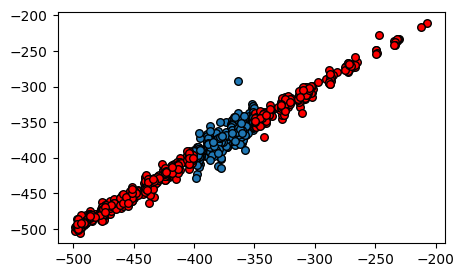

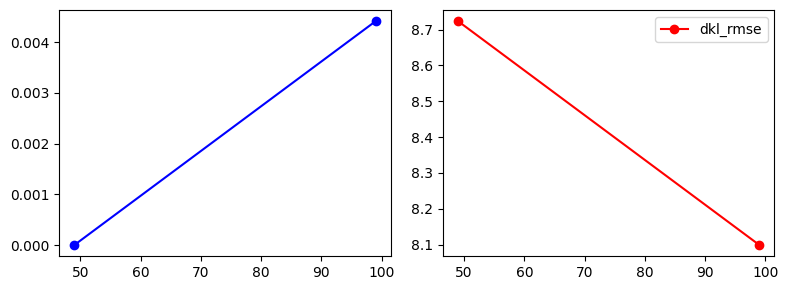

Epoch: 101 Training loss: 4471.2174 VAE loss: 30.9515 DKL loss: 4440.2659
Epoch: 102 Training loss: 4467.7696 VAE loss: 30.8829 DKL loss: 4436.8867
Epoch: 103 Training loss: 4430.8419 VAE loss: 30.8412 DKL loss: 4400.0007
Epoch: 104 Training loss: 4390.2000 VAE loss: 30.7488 DKL loss: 4359.4511
Epoch: 105 Training loss: 4369.2124 VAE loss: 30.7078 DKL loss: 4338.5046
Epoch: 106 Training loss: 4362.4025 VAE loss: 30.6409 DKL loss: 4331.7617
Epoch: 107 Training loss: 4329.4959 VAE loss: 30.5758 DKL loss: 4298.9201
Epoch: 108 Training loss: 4290.2524 VAE loss: 30.4962 DKL loss: 4259.7563
Epoch: 109 Training loss: 4262.3695 VAE loss: 30.4406 DKL loss: 4231.9289
Epoch: 110 Training loss: 4270.4592 VAE loss: 30.3793 DKL loss: 4240.0800
Epoch: 111 Training loss: 4259.4877 VAE loss: 30.3123 DKL loss: 4229.1754
Epoch: 112 Training loss: 4251.4088 VAE loss: 30.2669 DKL loss: 4221.1419
Epoch: 113 Training loss: 4255.9544 VAE loss: 30.2400 DKL loss: 4225.7144
Epoch: 114 Training loss: 4273.9390 VA

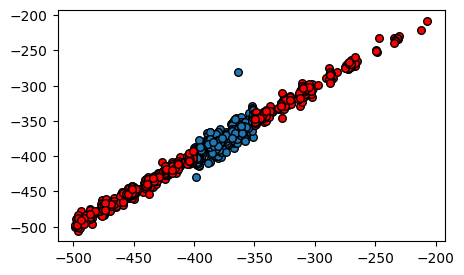

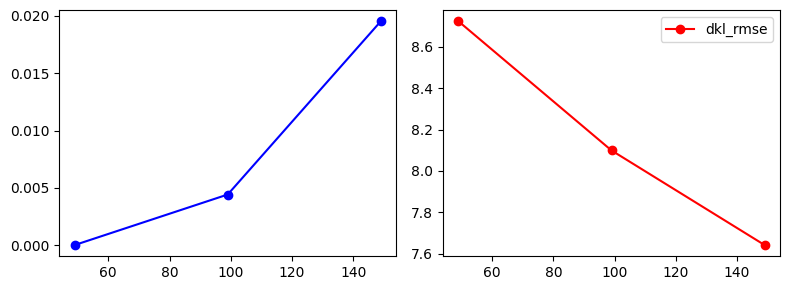

Epoch: 151 Training loss: 3765.9146 VAE loss: 28.2809 DKL loss: 3737.6337
Epoch: 152 Training loss: 3757.3438 VAE loss: 28.2631 DKL loss: 3729.0807
Epoch: 153 Training loss: 3780.6630 VAE loss: 28.2065 DKL loss: 3752.4565
Epoch: 154 Training loss: 3754.9456 VAE loss: 28.1720 DKL loss: 3726.7736
Epoch: 155 Training loss: 3730.7494 VAE loss: 28.1357 DKL loss: 3702.6137
Epoch: 156 Training loss: 3722.9944 VAE loss: 28.1049 DKL loss: 3694.8896
Epoch: 157 Training loss: 3690.6443 VAE loss: 28.0384 DKL loss: 3662.6059
Epoch: 158 Training loss: 3671.6144 VAE loss: 28.0219 DKL loss: 3643.5925
Epoch: 159 Training loss: 3639.0893 VAE loss: 27.9338 DKL loss: 3611.1555
Epoch: 160 Training loss: 3649.2917 VAE loss: 27.9236 DKL loss: 3621.3681
Epoch: 161 Training loss: 3650.4573 VAE loss: 27.8684 DKL loss: 3622.5889
Epoch: 162 Training loss: 3658.4731 VAE loss: 27.8632 DKL loss: 3630.6099
Epoch: 163 Training loss: 3636.1651 VAE loss: 27.8035 DKL loss: 3608.3616
Epoch: 164 Training loss: 3631.4248 VA

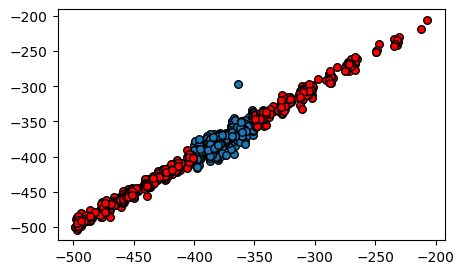

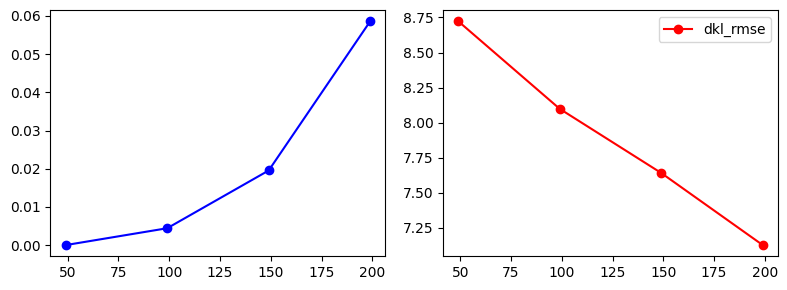

Epoch: 201 Training loss: 3345.9590 VAE loss: 26.5555 DKL loss: 3319.4035
Epoch: 202 Training loss: 3323.0771 VAE loss: 26.5646 DKL loss: 3296.5125
Epoch: 203 Training loss: 3308.0391 VAE loss: 26.5147 DKL loss: 3281.5245
Epoch: 204 Training loss: 3236.6939 VAE loss: 26.5263 DKL loss: 3210.1676
Epoch: 205 Training loss: 3186.8671 VAE loss: 26.4949 DKL loss: 3160.3722
Epoch: 206 Training loss: 3155.7937 VAE loss: 26.4807 DKL loss: 3129.3130
Epoch: 207 Training loss: 3169.2126 VAE loss: 26.3986 DKL loss: 3142.8140
Epoch: 208 Training loss: 3151.4775 VAE loss: 26.3724 DKL loss: 3125.1051
Epoch: 209 Training loss: 3138.7184 VAE loss: 26.3719 DKL loss: 3112.3466
Epoch: 210 Training loss: 3113.0998 VAE loss: 26.3511 DKL loss: 3086.7487
Epoch: 211 Training loss: 3100.7021 VAE loss: 26.3281 DKL loss: 3074.3740
Epoch: 212 Training loss: 3111.7504 VAE loss: 26.3175 DKL loss: 3085.4329
Epoch: 213 Training loss: 3106.0421 VAE loss: 26.2769 DKL loss: 3079.7652
Epoch: 214 Training loss: 3087.7263 VA

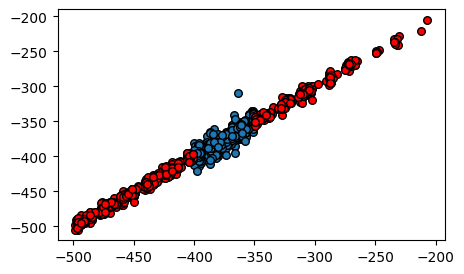

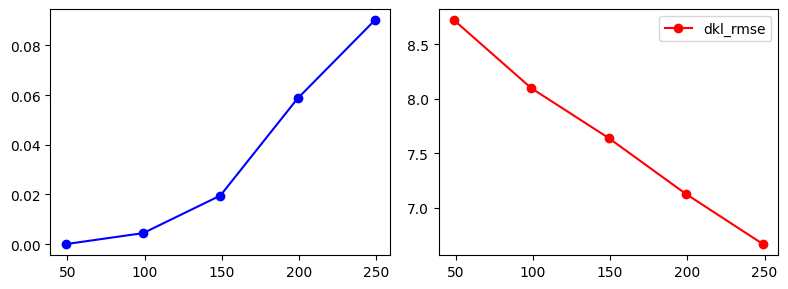

Epoch: 251 Training loss: 2710.4493 VAE loss: 25.5329 DKL loss: 2684.9163
Epoch: 252 Training loss: 2680.6895 VAE loss: 25.5068 DKL loss: 2655.1827
Epoch: 253 Training loss: 2695.8770 VAE loss: 25.5011 DKL loss: 2670.3759
Epoch: 254 Training loss: 2699.9722 VAE loss: 25.4649 DKL loss: 2674.5072
Epoch: 255 Training loss: 2729.5364 VAE loss: 25.4295 DKL loss: 2704.1069
Epoch: 256 Training loss: 2705.0870 VAE loss: 25.4366 DKL loss: 2679.6504
Epoch: 257 Training loss: 2660.7660 VAE loss: 25.4344 DKL loss: 2635.3316
Epoch: 258 Training loss: 2654.4962 VAE loss: 25.4121 DKL loss: 2629.0841
Epoch: 259 Training loss: 2624.2169 VAE loss: 25.3969 DKL loss: 2598.8200
Epoch: 260 Training loss: 2636.6250 VAE loss: 25.3439 DKL loss: 2611.2812
Epoch: 261 Training loss: 2668.5282 VAE loss: 25.3268 DKL loss: 2643.2014
Epoch: 262 Training loss: 2719.1666 VAE loss: 25.3177 DKL loss: 2693.8489
Epoch: 263 Training loss: 2689.1722 VAE loss: 25.3052 DKL loss: 2663.8670
Epoch: 264 Training loss: 2656.3064 VA

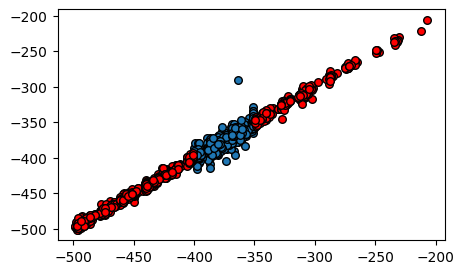

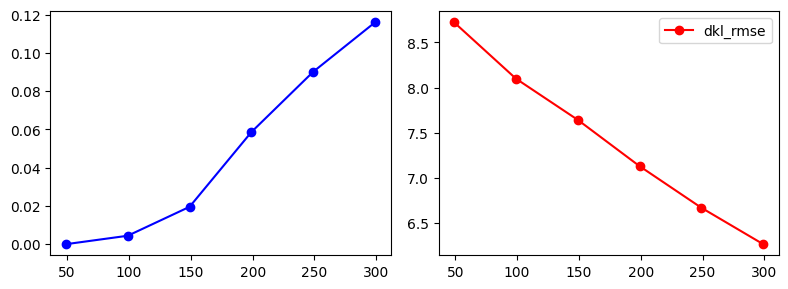

Epoch: 301 Training loss: 2272.2133 VAE loss: 24.7736 DKL loss: 2247.4397
Epoch: 302 Training loss: 2287.0514 VAE loss: 24.8182 DKL loss: 2262.2332
Epoch: 303 Training loss: 2293.3541 VAE loss: 24.7697 DKL loss: 2268.5845
Epoch: 304 Training loss: 2375.9794 VAE loss: 24.7695 DKL loss: 2351.2099
Epoch: 305 Training loss: 2330.2564 VAE loss: 24.7489 DKL loss: 2305.5075
Epoch: 306 Training loss: 2358.0761 VAE loss: 24.7585 DKL loss: 2333.3176
Epoch: 307 Training loss: 2305.4991 VAE loss: 24.7187 DKL loss: 2280.7804
Epoch: 308 Training loss: 2306.7833 VAE loss: 24.7089 DKL loss: 2282.0744
Epoch: 309 Training loss: 2284.3289 VAE loss: 24.7062 DKL loss: 2259.6227
Epoch: 310 Training loss: 2335.0746 VAE loss: 24.7151 DKL loss: 2310.3595
Epoch: 311 Training loss: 2333.0677 VAE loss: 24.7423 DKL loss: 2308.3253
Epoch: 312 Training loss: 2331.6222 VAE loss: 24.6380 DKL loss: 2306.9842
Epoch: 313 Training loss: 2298.9075 VAE loss: 24.7076 DKL loss: 2274.1998
Epoch: 314 Training loss: 2256.7161 VA

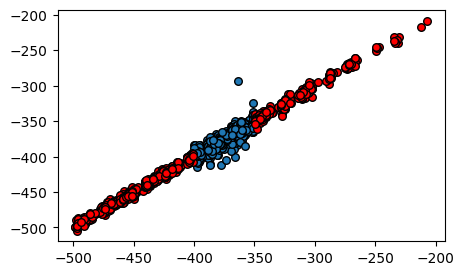

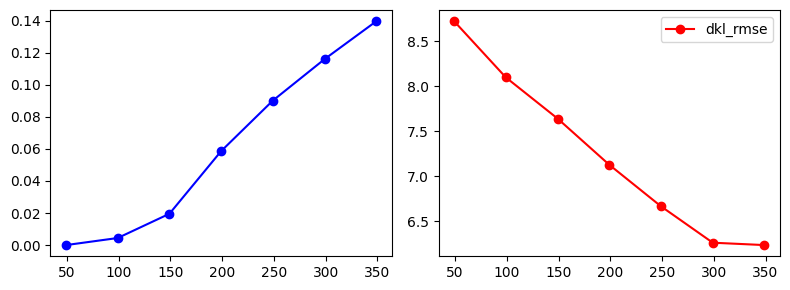

Epoch: 351 Training loss: 2071.5085 VAE loss: 24.3088 DKL loss: 2047.1997
Epoch: 352 Training loss: 2029.3202 VAE loss: 24.2725 DKL loss: 2005.0477
Epoch: 353 Training loss: 1961.8668 VAE loss: 24.2343 DKL loss: 1937.6325
Epoch: 354 Training loss: 2026.6996 VAE loss: 24.2176 DKL loss: 2002.4820
Epoch: 355 Training loss: 2106.9737 VAE loss: 24.2559 DKL loss: 2082.7178
Epoch: 356 Training loss: 2268.9936 VAE loss: 24.2849 DKL loss: 2244.7087
Epoch: 357 Training loss: 2220.7429 VAE loss: 24.2532 DKL loss: 2196.4897
Epoch: 358 Training loss: 2146.3195 VAE loss: 24.2407 DKL loss: 2122.0788
Epoch: 359 Training loss: 2055.7936 VAE loss: 24.2044 DKL loss: 2031.5892
Epoch: 360 Training loss: 1998.7640 VAE loss: 24.1745 DKL loss: 1974.5896
Epoch: 361 Training loss: 1980.4688 VAE loss: 24.2411 DKL loss: 1956.2277
Epoch: 362 Training loss: 1970.2436 VAE loss: 24.1665 DKL loss: 1946.0771
Epoch: 363 Training loss: 1992.8668 VAE loss: 24.1705 DKL loss: 1968.6963
Epoch: 364 Training loss: 1983.0412 VA

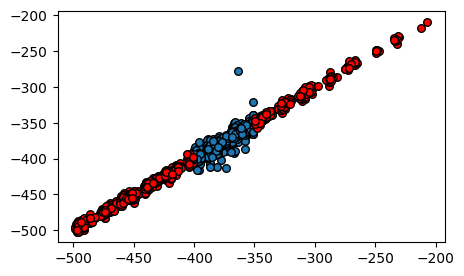

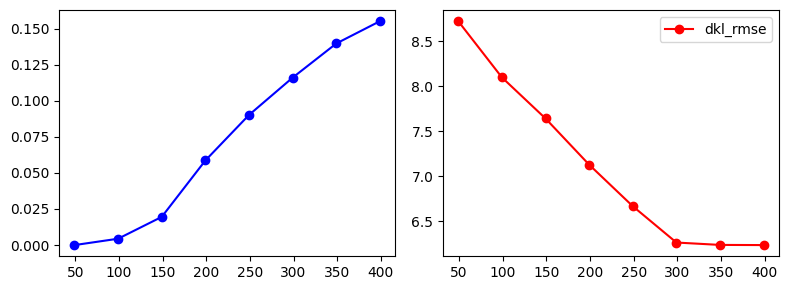

Epoch: 401 Training loss: 1897.0479 VAE loss: 23.9097 DKL loss: 1873.1382
Epoch: 402 Training loss: 1850.0744 VAE loss: 23.8886 DKL loss: 1826.1858
Epoch: 403 Training loss: 1870.2836 VAE loss: 23.8544 DKL loss: 1846.4292
Epoch: 404 Training loss: 1900.5466 VAE loss: 23.8733 DKL loss: 1876.6734
Epoch: 405 Training loss: 1944.8914 VAE loss: 23.8544 DKL loss: 1921.0370
Epoch: 406 Training loss: 1941.9080 VAE loss: 23.8412 DKL loss: 1918.0669
Epoch: 407 Training loss: 1941.1612 VAE loss: 23.8340 DKL loss: 1917.3272
Epoch: 408 Training loss: 1878.6540 VAE loss: 23.8352 DKL loss: 1854.8188
Epoch: 409 Training loss: 1865.3656 VAE loss: 23.8705 DKL loss: 1841.4952
Epoch: 410 Training loss: 1836.1107 VAE loss: 23.8167 DKL loss: 1812.2940
Epoch: 411 Training loss: 1815.0940 VAE loss: 23.7992 DKL loss: 1791.2948
Epoch: 412 Training loss: 1802.5826 VAE loss: 23.8065 DKL loss: 1778.7761
Epoch: 413 Training loss: 1820.3090 VAE loss: 23.8168 DKL loss: 1796.4922
Epoch: 414 Training loss: 1859.0022 VA

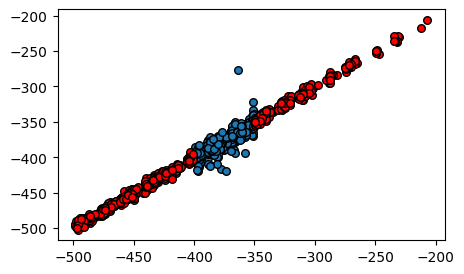

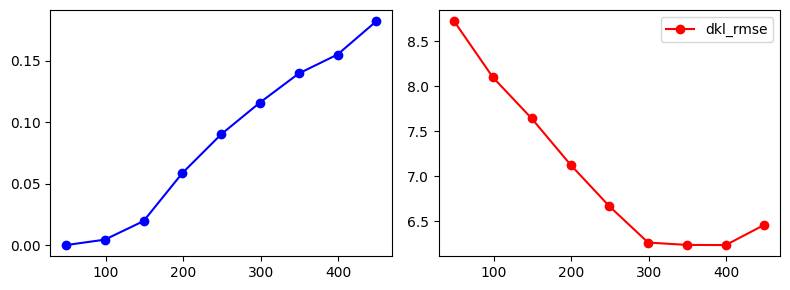

Epoch: 451 Training loss: 1812.9243 VAE loss: 23.5620 DKL loss: 1789.3623
Epoch: 452 Training loss: 1789.8417 VAE loss: 23.6136 DKL loss: 1766.2282
Epoch: 453 Training loss: 1807.4615 VAE loss: 23.5413 DKL loss: 1783.9202
Epoch: 454 Training loss: 1839.1891 VAE loss: 23.5461 DKL loss: 1815.6431
Epoch: 455 Training loss: 1837.1082 VAE loss: 23.5696 DKL loss: 1813.5387
Epoch: 456 Training loss: 1831.8615 VAE loss: 23.5563 DKL loss: 1808.3052
Epoch: 457 Training loss: 1802.4629 VAE loss: 23.5624 DKL loss: 1778.9005
Epoch: 458 Training loss: 1742.4553 VAE loss: 23.5400 DKL loss: 1718.9153
Epoch: 459 Training loss: 1705.1278 VAE loss: 23.5232 DKL loss: 1681.6046
Epoch: 460 Training loss: 1734.5114 VAE loss: 23.5754 DKL loss: 1710.9360
Epoch: 461 Training loss: 1839.8883 VAE loss: 23.5450 DKL loss: 1816.3432
Epoch: 462 Training loss: 1905.6727 VAE loss: 23.5271 DKL loss: 1882.1456
Epoch: 463 Training loss: 1928.6786 VAE loss: 23.4868 DKL loss: 1905.1918
Epoch: 464 Training loss: 1736.5256 VA

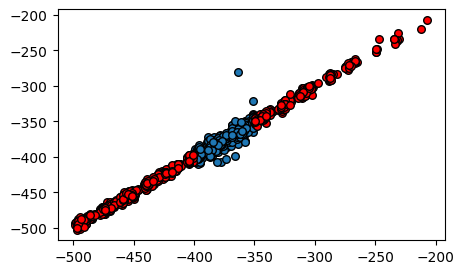

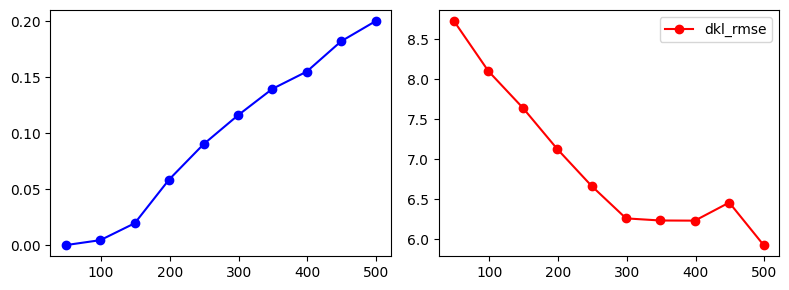

Epoch: 501 Training loss: 1783.3582 VAE loss: 23.3383 DKL loss: 1760.0199
Epoch: 502 Training loss: 1743.6372 VAE loss: 23.3297 DKL loss: 1720.3075
Epoch: 503 Training loss: 1618.7187 VAE loss: 23.2949 DKL loss: 1595.4237
Epoch: 504 Training loss: 1611.1382 VAE loss: 23.3065 DKL loss: 1587.8317
Epoch: 505 Training loss: 1625.2541 VAE loss: 23.3266 DKL loss: 1601.9276
Epoch: 506 Training loss: 1700.7211 VAE loss: 23.2656 DKL loss: 1677.4555
Epoch: 507 Training loss: 1703.4400 VAE loss: 23.2900 DKL loss: 1680.1500
Epoch: 508 Training loss: 1674.8842 VAE loss: 23.2876 DKL loss: 1651.5965
Epoch: 509 Training loss: 1628.5721 VAE loss: 23.2965 DKL loss: 1605.2756
Epoch: 510 Training loss: 1601.8325 VAE loss: 23.2808 DKL loss: 1578.5517
Epoch: 511 Training loss: 1609.6790 VAE loss: 23.3059 DKL loss: 1586.3731
Epoch: 512 Training loss: 1670.8274 VAE loss: 23.2879 DKL loss: 1647.5395
Epoch: 513 Training loss: 1742.8898 VAE loss: 23.2848 DKL loss: 1719.6050
Epoch: 514 Training loss: 1736.0472 VA

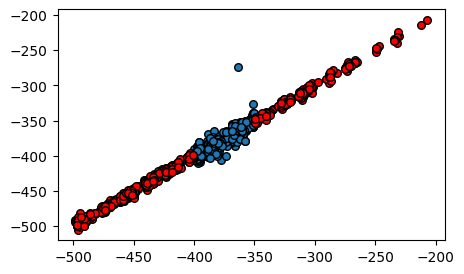

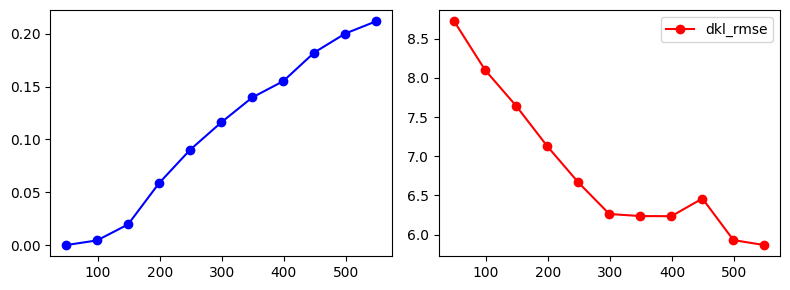

Epoch: 551 Training loss: 1580.2148 VAE loss: 23.1168 DKL loss: 1557.0979
Epoch: 552 Training loss: 1603.2158 VAE loss: 23.1190 DKL loss: 1580.0969
Epoch: 553 Training loss: 1644.6499 VAE loss: 23.0868 DKL loss: 1621.5631
Epoch: 554 Training loss: 1659.1370 VAE loss: 23.0530 DKL loss: 1636.0840
Epoch: 555 Training loss: 1645.0604 VAE loss: 23.0684 DKL loss: 1621.9920
Epoch: 556 Training loss: 1631.0671 VAE loss: 23.1111 DKL loss: 1607.9561
Epoch: 557 Training loss: 1631.6502 VAE loss: 23.0946 DKL loss: 1608.5556
Epoch: 558 Training loss: 1620.0235 VAE loss: 23.0407 DKL loss: 1596.9828
Epoch: 559 Training loss: 1609.5220 VAE loss: 23.0805 DKL loss: 1586.4415
Epoch: 560 Training loss: 1606.7494 VAE loss: 23.0803 DKL loss: 1583.6691
Epoch: 561 Training loss: 1633.9956 VAE loss: 23.0718 DKL loss: 1610.9238
Epoch: 562 Training loss: 1618.3368 VAE loss: 23.0427 DKL loss: 1595.2941
Epoch: 563 Training loss: 1620.9389 VAE loss: 23.0763 DKL loss: 1597.8626
Epoch: 564 Training loss: 1600.2046 VA

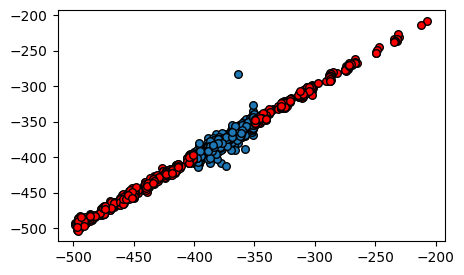

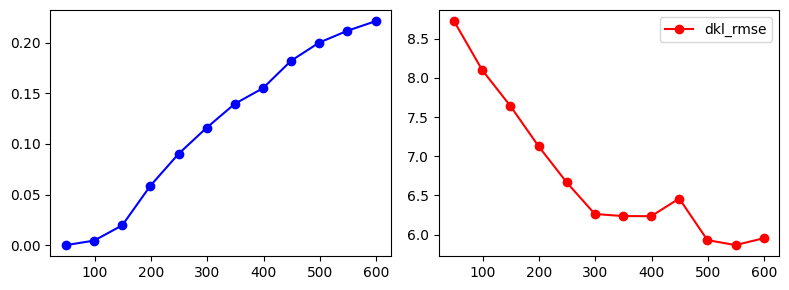

Epoch: 601 Training loss: 1632.1884 VAE loss: 22.9262 DKL loss: 1609.2622
Epoch: 602 Training loss: 1566.8341 VAE loss: 22.9206 DKL loss: 1543.9135
Epoch: 603 Training loss: 1534.0890 VAE loss: 22.9430 DKL loss: 1511.1460
Epoch: 604 Training loss: 1514.1941 VAE loss: 22.9519 DKL loss: 1491.2422
Epoch: 605 Training loss: 1539.6716 VAE loss: 22.9146 DKL loss: 1516.7571
Epoch: 606 Training loss: 1583.0640 VAE loss: 22.8854 DKL loss: 1560.1786
Epoch: 607 Training loss: 1573.0325 VAE loss: 22.9088 DKL loss: 1550.1236
Epoch: 608 Training loss: 1576.3409 VAE loss: 22.9092 DKL loss: 1553.4317
Epoch: 609 Training loss: 1575.1608 VAE loss: 22.9051 DKL loss: 1552.2557
Epoch: 610 Training loss: 1576.0991 VAE loss: 22.9327 DKL loss: 1553.1664
Epoch: 611 Training loss: 1582.8233 VAE loss: 22.8775 DKL loss: 1559.9458
Epoch: 612 Training loss: 1548.7718 VAE loss: 22.8821 DKL loss: 1525.8898
Epoch: 613 Training loss: 1532.1455 VAE loss: 22.9101 DKL loss: 1509.2354
Epoch: 614 Training loss: 1518.6168 VA

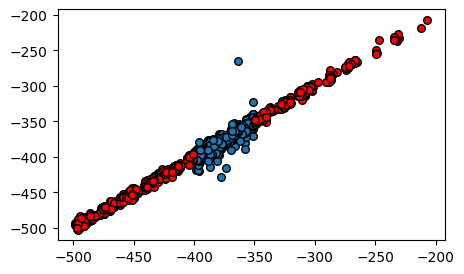

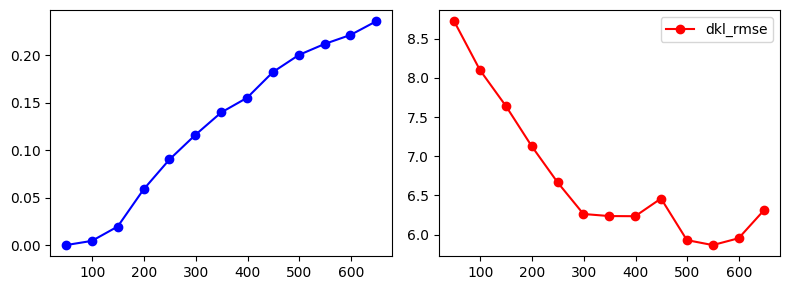

Epoch: 651 Training loss: 1541.3071 VAE loss: 22.7469 DKL loss: 1518.5602
Epoch: 652 Training loss: 1466.5749 VAE loss: 22.7450 DKL loss: 1443.8299
Epoch: 653 Training loss: 1442.3573 VAE loss: 22.7901 DKL loss: 1419.5671
Epoch: 654 Training loss: 1414.5546 VAE loss: 22.7561 DKL loss: 1391.7985
Epoch: 655 Training loss: 1445.0818 VAE loss: 22.7844 DKL loss: 1422.2974
Epoch: 656 Training loss: 1443.9776 VAE loss: 22.7747 DKL loss: 1421.2029
Epoch: 657 Training loss: 1487.2615 VAE loss: 22.7643 DKL loss: 1464.4972
Epoch: 658 Training loss: 1522.2391 VAE loss: 22.7555 DKL loss: 1499.4836
Epoch: 659 Training loss: 1600.7629 VAE loss: 22.7773 DKL loss: 1577.9856
Epoch: 660 Training loss: 1678.7812 VAE loss: 22.8026 DKL loss: 1655.9785
Epoch: 661 Training loss: 1596.7677 VAE loss: 22.7390 DKL loss: 1574.0286
Epoch: 662 Training loss: 1511.1034 VAE loss: 22.6686 DKL loss: 1488.4348
Epoch: 663 Training loss: 1433.0219 VAE loss: 22.7558 DKL loss: 1410.2662
Epoch: 664 Training loss: 1436.7269 VA

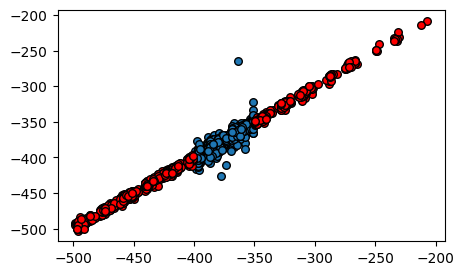

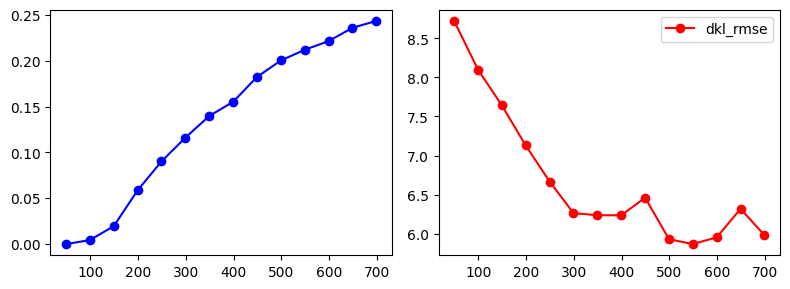

Epoch: 701 Training loss: 1467.4478 VAE loss: 22.6081 DKL loss: 1444.8397
Epoch: 702 Training loss: 1478.3812 VAE loss: 22.6455 DKL loss: 1455.7357
Epoch: 703 Training loss: 1452.1725 VAE loss: 22.6605 DKL loss: 1429.5120
Epoch: 704 Training loss: 1460.2822 VAE loss: 22.6219 DKL loss: 1437.6603
Epoch: 705 Training loss: 1429.7980 VAE loss: 22.6082 DKL loss: 1407.1898
Epoch: 706 Training loss: 1440.3780 VAE loss: 22.6594 DKL loss: 1417.7186
Epoch: 707 Training loss: 1436.8266 VAE loss: 22.6437 DKL loss: 1414.1829
Epoch: 708 Training loss: 1480.7034 VAE loss: 22.6472 DKL loss: 1458.0561
Epoch: 709 Training loss: 1525.0606 VAE loss: 22.6219 DKL loss: 1502.4386
Epoch: 710 Training loss: 1552.7804 VAE loss: 22.5922 DKL loss: 1530.1882
Epoch: 711 Training loss: 1510.1918 VAE loss: 22.6242 DKL loss: 1487.5676
Epoch: 712 Training loss: 1466.7628 VAE loss: 22.6052 DKL loss: 1444.1577
Epoch: 713 Training loss: 1444.8778 VAE loss: 22.6126 DKL loss: 1422.2652
Epoch: 714 Training loss: 1460.3286 VA

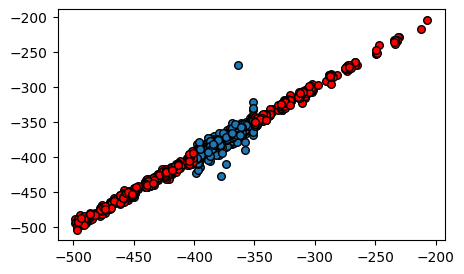

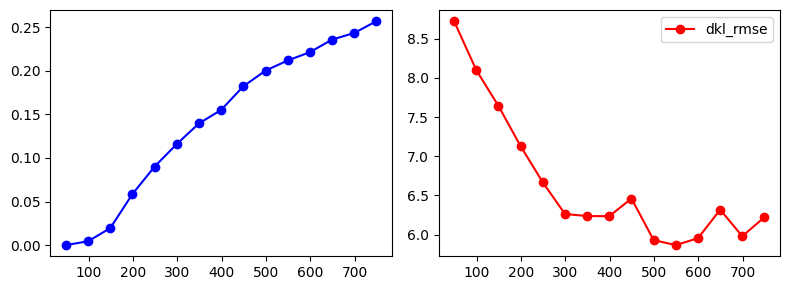

Epoch: 751 Training loss: 1500.6576 VAE loss: 22.5169 DKL loss: 1478.1406
Epoch: 752 Training loss: 1513.2013 VAE loss: 22.5343 DKL loss: 1490.6670
Epoch: 753 Training loss: 1471.9104 VAE loss: 22.5320 DKL loss: 1449.3784
Epoch: 754 Training loss: 1474.4729 VAE loss: 22.4993 DKL loss: 1451.9736
Epoch: 755 Training loss: 1464.9655 VAE loss: 22.5102 DKL loss: 1442.4554
Epoch: 756 Training loss: 1458.7014 VAE loss: 22.5317 DKL loss: 1436.1697
Epoch: 757 Training loss: 1444.4836 VAE loss: 22.5424 DKL loss: 1421.9413
Epoch: 758 Training loss: 1432.6943 VAE loss: 22.4835 DKL loss: 1410.2108
Epoch: 759 Training loss: 1420.7159 VAE loss: 22.5292 DKL loss: 1398.1867
Epoch: 760 Training loss: 1425.1606 VAE loss: 22.5332 DKL loss: 1402.6274
Epoch: 761 Training loss: 1418.9407 VAE loss: 22.4679 DKL loss: 1396.4728
Epoch: 762 Training loss: 1449.5546 VAE loss: 22.4585 DKL loss: 1427.0961
Epoch: 763 Training loss: 1484.2021 VAE loss: 22.5138 DKL loss: 1461.6882
Epoch: 764 Training loss: 1518.0920 VA

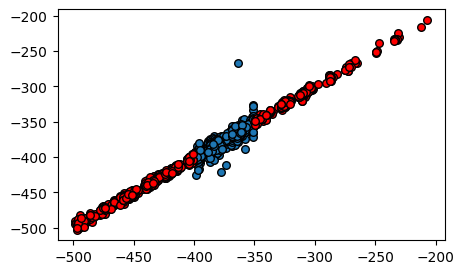

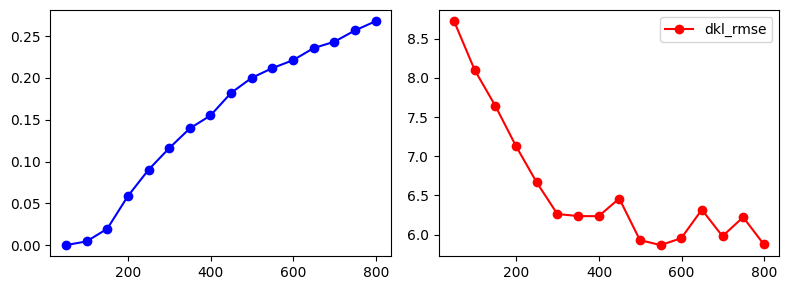

Epoch: 801 Training loss: 1347.7002 VAE loss: 22.4177 DKL loss: 1325.2826
Epoch: 802 Training loss: 1347.3470 VAE loss: 22.3991 DKL loss: 1324.9479
Epoch: 803 Training loss: 1358.4372 VAE loss: 22.4172 DKL loss: 1336.0201
Epoch: 804 Training loss: 1370.9883 VAE loss: 22.3894 DKL loss: 1348.5989
Epoch: 805 Training loss: 1380.1416 VAE loss: 22.4030 DKL loss: 1357.7386
Epoch: 806 Training loss: 1392.2994 VAE loss: 22.3717 DKL loss: 1369.9277
Epoch: 807 Training loss: 1394.8673 VAE loss: 22.4024 DKL loss: 1372.4650
Epoch: 808 Training loss: 1395.1660 VAE loss: 22.4053 DKL loss: 1372.7608
Epoch: 809 Training loss: 1389.8635 VAE loss: 22.4316 DKL loss: 1367.4320
Epoch: 810 Training loss: 1373.5272 VAE loss: 22.3873 DKL loss: 1351.1399
Epoch: 811 Training loss: 1345.8329 VAE loss: 22.4039 DKL loss: 1323.4290
Epoch: 812 Training loss: 1342.0052 VAE loss: 22.3784 DKL loss: 1319.6268
Epoch: 813 Training loss: 1366.8463 VAE loss: 22.3700 DKL loss: 1344.4763
Epoch: 814 Training loss: 1390.4751 VA

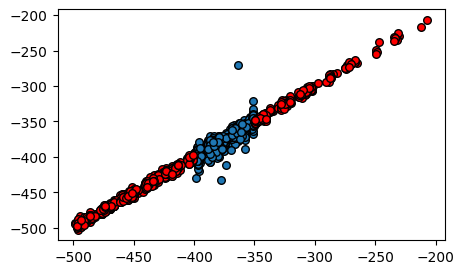

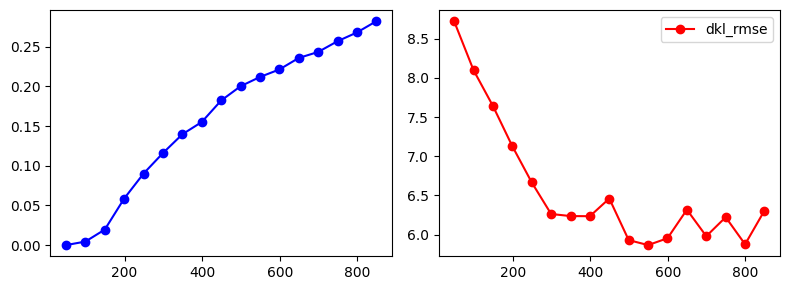

Epoch: 851 Training loss: 1402.0751 VAE loss: 22.2911 DKL loss: 1379.7840
Epoch: 852 Training loss: 1398.5964 VAE loss: 22.3504 DKL loss: 1376.2460
Epoch: 853 Training loss: 1417.5130 VAE loss: 22.3044 DKL loss: 1395.2086
Epoch: 854 Training loss: 1418.6244 VAE loss: 22.3258 DKL loss: 1396.2987
Epoch: 855 Training loss: 1448.4523 VAE loss: 22.3175 DKL loss: 1426.1348
Epoch: 856 Training loss: 1409.1462 VAE loss: 22.3235 DKL loss: 1386.8228
Epoch: 857 Training loss: 1396.1656 VAE loss: 22.2981 DKL loss: 1373.8675
Epoch: 858 Training loss: 1358.2541 VAE loss: 22.3132 DKL loss: 1335.9409
Epoch: 859 Training loss: 1380.6909 VAE loss: 22.3165 DKL loss: 1358.3744
Epoch: 860 Training loss: 1399.1469 VAE loss: 22.3061 DKL loss: 1376.8408
Epoch: 861 Training loss: 1473.0372 VAE loss: 22.2799 DKL loss: 1450.7572
Epoch: 862 Training loss: 1470.7333 VAE loss: 22.3010 DKL loss: 1448.4323
Epoch: 863 Training loss: 1446.3842 VAE loss: 22.3081 DKL loss: 1424.0761
Epoch: 864 Training loss: 1428.4390 VA

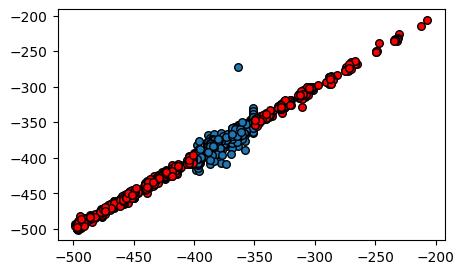

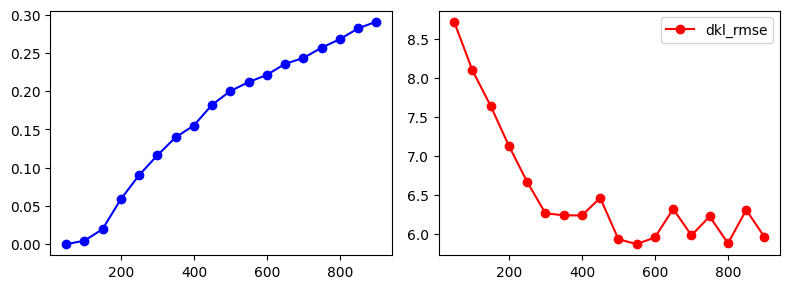

In [66]:
#@title train
vae_accuracy = np.array([])
dkl_rmse = np.array([])
epoches = np.array([])

for e in range(900):
    #train_vae = 0 if e < 200 else 1  # we can start training VAE e.g. after 200 epochs
    trainer.step(dataloader, train_vae=True)
    trainer.print_statistics()
    if (e+1) % 50 == 0:
      #..........................................
      #_______ prediction plot____________
      #..........................................
      test_mean_m, test_cov_m = model.dkl_predict(torch_mol_test);
      train_mean_m,train_cov_m = model.dkl_predict(torch_mol_train[:800]);

      fig = plt.figure(figsize=(5,3))
      plt.scatter(targets3_test[:800], test_mean_m[:800],
                  s=30, ec='black', label='test')
      plt.scatter(targets3_train[:800], train_mean_m,
                   c='r',s=30, ec='black', label='train')
      plt.show()

      #..........................................
      #_______ RMSE and VAE accuracy____________
      #..........................................
      vae_pred = model.vae_predict(torch_mol_test)
      element_wise_comparison = (torch_mol_test.reshape(-1,*data_dim) == vae_pred)
      overall_accuracy = np.mean((element_wise_comparison.all(axis=(1,2))).numpy())

      vae_accuracy = np.append(vae_accuracy, overall_accuracy)
      dkl_rmse = np.append(dkl_rmse,
                           np.sqrt(np.mean((test_mean_m.numpy() - targets3_test) ** 2)))
      epoches = np.append(epoches, e)

      fig, ax = plt.subplots(1, 2, figsize=(8,3))
      ax[0].plot(epoches, vae_accuracy, 'o-', label='vae_accuracy', c='b')
      ax[1].plot(epoches, dkl_rmse, 'o-', label='dkl_rmse', c='r')
      plt.tight_layout()
      plt.legend()
      plt.show()


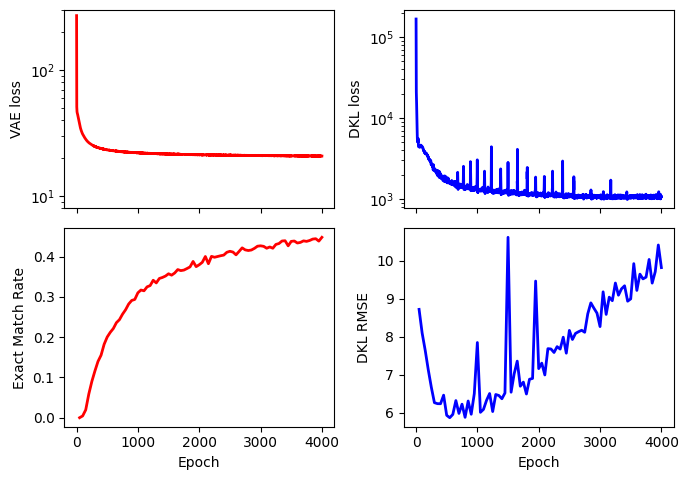

In [ ]:
fig, ax = plt.subplots(2,2, figsize=(7,4.9), sharex=True)

ax[0,0].plot(trainer.loss_history['vae_loss'], color='r', lw=2)
ax[0,1].plot(trainer.loss_history['dkl_loss'], color='b', lw=2)

ax[0,0].set_yscale('log')
ax[0,0].set_ylim(8,3e2)
ax[0,0].set_ylabel('VAE loss')
ax[0,1].set_yscale('log')
ax[0,1].set_ylabel('DKL loss')

ax[1,0].plot(epoches, vae_accuracy, c='r', lw=2)
ax[1,1].plot(epoches, dkl_rmse, c='b', lw=2)

ax[1,0].set_ylabel('Exact Match Rate')
ax[1,1].set_ylabel('DKL RMSE')

for _ in ax[1]:
  _.set_xlabel('Epoch')

plt.tight_layout()
fig.savefig('fig7_new.jpg', dpi=300, bbox_inches='tight')

## tsne

In [ ]:
v_train, _ = model.encode(torch_mol_train)
v_test, _ = model.encode(torch_mol_test)
v_all = np.concatenate([v_train, v_test])
inds = np.concatenate([np.zeros(v_train.shape[0]), np.ones(v_test.shape[0])])
sort_enth = np.concatenate([targets3_train, targets3_test])

In [ ]:
from sklearn.manifold import TSNE
import seaborn as sns

In [ ]:
tsne = TSNE(n_components=2, perplexity=50, learning_rate=300, random_state=42)
latent_2d = tsne.fit_transform(v_all)

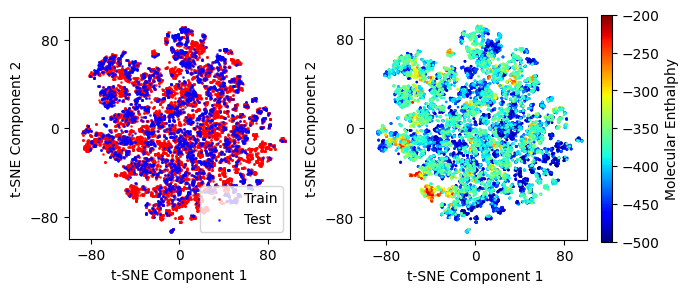

In [ ]:
fig,ax = plt.subplots(1,2, figsize=(7,3), gridspec_kw={'width_ratios': [3.1,3.9]})

ax[0].scatter(*latent_2d[inds==0].T, s=1, c='r', alpha=.7, label='Train')
ax[0].set_aspect('equal')
ax[0].scatter(*latent_2d[inds==1].T, s=1, c='b', alpha=.7, label='Test')
ax[0].legend()

im = ax[1].scatter(*latent_2d.T, s=1, cmap='jet', c=sort_enth, vmin=-500, vmax=-200)
ax[1].set_aspect('equal')
cbar = plt.colorbar(im)
cbar.set_label('Molecular Enthalphy')

for _ in ax:
  _.set_xlabel('t-SNE Component 1')
  _.set_ylabel('t-SNE Component 2')
  _.set_xticks(np.linspace(-80,80,3))
  _.set_yticks(np.linspace(-80,80,3))
  _.set_xlim(-100,100)
  _.set_ylim(-100,100)
  _.set_aspect('equal')

plt.tight_layout()
fig.savefig('tsne_lat_space_new.jpg', dpi=300, bbox_inches='tight')

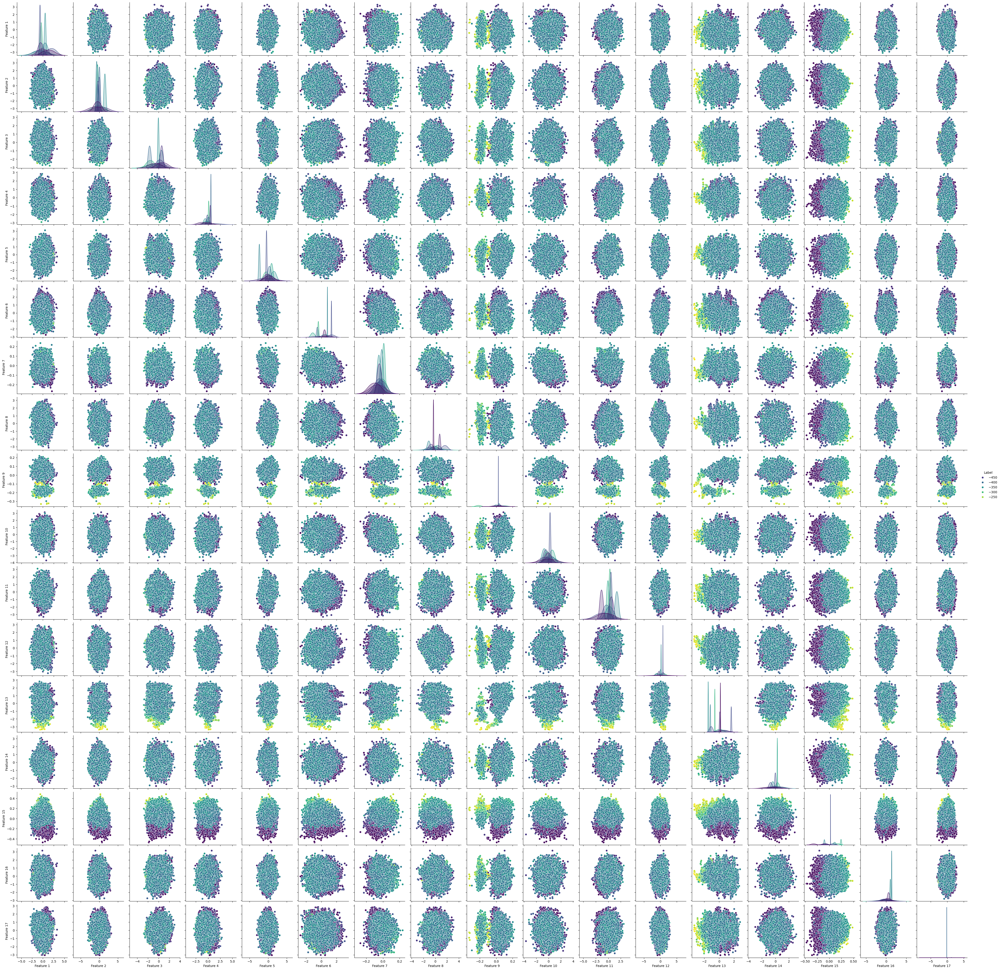

In [ ]:
dff = pd.DataFrame(v_all, columns=[f'Feature {i+1}' for i in range(v_all.shape[1])])
dff['Label'] = sort_enth
sns.pairplot(dff, hue='Label', palette='viridis', diag_kind='kde')

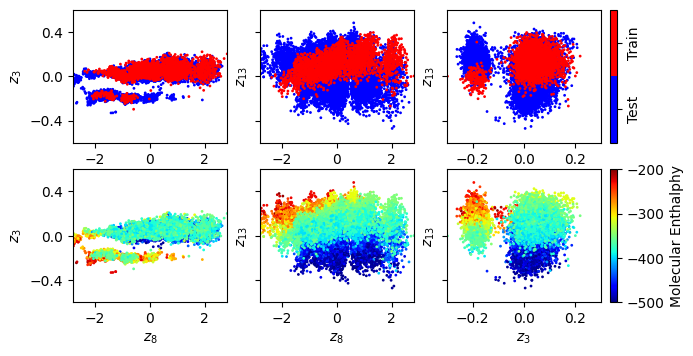

In [ ]:
latent_variables = [8, 12, 14]
import matplotlib.colors as mcolors

cmap = mcolors.ListedColormap(['blue', 'red'])  # 0 = blue, 1 = red
bounds = [0, .5, 1]  # Define boundaries for colorbar
norm = mcolors.BoundaryNorm(bounds, cmap.N)

fig,ax = plt.subplots(2,3, figsize=(7.3,3.8), sharey=True, gridspec_kw={'width_ratios': [2,2,2.5]})


ax[0,0].scatter(v_all.T[12], v_all.T[8] , s=1, cmap=cmap, c=inds)
ax[0,1].scatter(v_all.T[12], v_all.T[14], s=1, cmap=cmap, c=inds)
im = ax[0,2].scatter(v_all.T[8], v_all.T[14], s=1, cmap=cmap, c=inds)
cbar1 = plt.colorbar(im, ax=ax[0,2], ticks=[0.25, .75])
cbar1.set_ticklabels(['Test', 'Train'], rotation=90, va='center')

ax[1,0].scatter(v_all.T[12], v_all.T[8] , s=1, cmap='jet', c=sort_enth, alpha=1)
ax[1,1].scatter(v_all.T[12], v_all.T[14], s=1, cmap='jet', c=sort_enth, alpha=1)
im1 =  ax[1,2].scatter(v_all.T[8], v_all.T[14],
                       s=1, cmap='jet', c=sort_enth,
                       alpha=1, vmin=-500, vmax=-200)

cbar1 = plt.colorbar(im1, ax=ax[1,2])
cbar1.set_label('Molecular Enthalphy')


for _ in ax.flatten():
  _.set_ylim(-.6, .6)
  _.set_yticks([-0.4, 0, 0.4])

for _ in ax[:,2]:
  _.set_xlim(-.3, .3)

for _ in ax[:,:2].flatten():
  _.set_xlim(-2.8, 2.8)

for _ in ax[:,1:3].flatten():
  _.set_ylabel(r'$z_{13}$')

for _ in ax[1,:2]:
  _.set_xlabel(r'$z_{8}$')

ax[0,0].set_ylabel(r'$z_{3}$')
ax[1,0].set_ylabel(r'$z_{3}$')
ax[1,2].set_xlabel(r'$z_{3}$')


fig.savefig('mol_lat_var_new.jpg', dpi=300, bbox_inches='tight')
#plt.tight_layout()

## dkl prediction

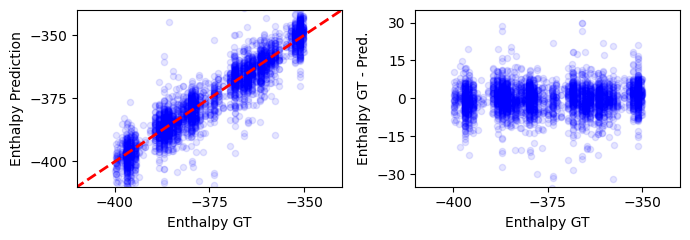

In [ ]:
fig,ax = plt.subplots(1,2, figsize=(7,2.5))

ax[0].scatter(targets3_test, test_mean_m, s=20, alpha=.1, ec='blue', c='b')
ax[1].scatter(targets3_test, test_mean_m - targets3_test,  ec='blue', c='b', s=20, alpha=.1,)


ax[0].set_ylabel('Enthalpy Prediction')
ax[1].set_ylabel('Enthalpy GT - Pred.')

ax[0].set_ylim(-410, -340)
ax[0].set_yticks([-400, -375, -350])
ax[1].set_ylim(-35, 35)
ax[1].set_yticks([-30, -15, 0, 15, 30])

ax[0].plot([-430,-300],[-430,-300], '--', color='r', lw=2)

for _ in ax:
  _.set_xlim(-410, -340)
  _.set_xticks([-400, -375, -350])
  _.set_xlabel('Enthalpy GT')

plt.tight_layout()
fig.savefig('fig8_new.jpg', dpi=300, bbox_inches='tight')

In [68]:
print(f'DKL_RMSE {round(dkl_rmse[-1],2)}')

DKL_RMSE 5.96


## vae reconstruction

In [ ]:
from collections import Counter

In [ ]:
def one_hot_to_smiles(one_hot_matrix, token_list):
    """
    Converts a one-hot encoded matrix back to a SMILES string.

    Parameters:
    - one_hot_matrix: numpy array of shape (sequence_length, vocab_size)
                      Each row represents a one-hot vector of a SELFIES token.
    - token_list: List of unique SELFIES tokens corresponding to vocab indices.

    Returns:
    - smiles_str: Decoded SMILES string.
    """
    # Convert one-hot vectors to indices
    indices = np.argmax(one_hot_matrix, axis=1)
    selfies_tokens = [token_list[i] for i in indices]
    selfies_tokens = [token for token in selfies_tokens if token != '[nop]']
    selfies_str = "".join(selfies_tokens)

    try:
        smiles_str = sf.decoder(selfies_str)
    except sf.DecoderError:
        smiles_str = None  # Return None if conversion fails

    return smiles_str

def compare_molecules(ground_truth, predicted):
    """
    Compare ground truth and predicted one-hot-encoded molecules in a 3D format.

    Parameters:
    ground_truth (np.ndarray): A 3D binary matrix representing ground truth (n_samples, n_rows, n_classes).
    predicted (np.ndarray): A 3D binary matrix representing predicted molecules (n_samples, n_rows, n_classes).

    Returns:
    dict: A dictionary with keys as error counts and values as the number of molecules with that many errors.
    """
    if ground_truth.shape != predicted.shape:
        raise ValueError("Ground truth and predicted arrays must have the same shape.")

    # Compute the number of mismatched bits per molecule
    errors_per_molecule = np.sum(ground_truth != predicted, axis=(1,2))

    # Count occurrences of each error level
    error_counts = Counter(errors_per_molecule)

    return dict(error_counts)

In [ ]:
test_molecules = torch_mol_test.reshape(-1,21,27)
prediction = model.vae_predict(torch_mol_test)

In [ ]:
prediction.shape, test_molecules.shape

(torch.Size([3172, 21, 27]), torch.Size([3172, 21, 27]))

In [ ]:
res = np.sum((test_molecules != prediction).any(axis=2).numpy(), axis=1)

In [ ]:
sorted_arr = np.sort(res)
element_counts = Counter(sorted_arr)

res_per = 100*np.array(list(element_counts.values()))/len(test_molecules)
er_n = element_counts.keys()

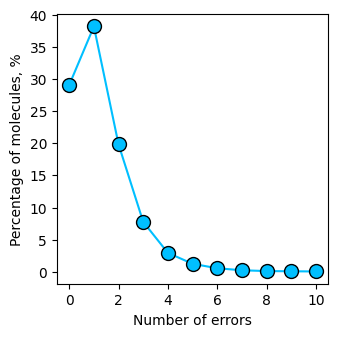

In [ ]:
fig = plt.figure(figsize=(3.5,3.5))

plt.plot(er_n, res_per, 'o-', mec='black', c='deepskyblue', ms=10)
plt.xlim(-.5,10.5)
plt.ylabel('Percentage of molecules, %')
plt.xlabel('Number of errors')

fig.savefig('error_dep_new.jpg', dpi=300, bbox_inches='tight')

In [ ]:
print(f'Exact match rate: {round(res_per[0],1)}%')
print(f'One error: {round(res_per[1],1)}%')
print(f'Less than 2 errors: {round(res_per[0]+res_per[1],1)}%')
print(f'Less than 3 errors: {round(res_per[0]+res_per[1]+res_per[2],1)}%')

Exact match rate: 29.1%
One error: 38.2%
Less than 2 errors: 67.3%
Less than 3 errors: 87.1%


In [ ]:
ii = [1, 290, 3]

gt_mol = [one_hot_to_smiles(test_molecules[iii], alphabet) for iii in ii]
pred_mol = [one_hot_to_smiles(prediction[iii], alphabet) for iii in ii]

gt_molecules = [Chem.MolFromSmiles(smiles) for smiles in gt_mol]
pr_molecules = [Chem.MolFromSmiles(smiles) for smiles in pred_mol]


[g == p for g, p in zip(gt_mol, pred_mol)]

[False, True, False]

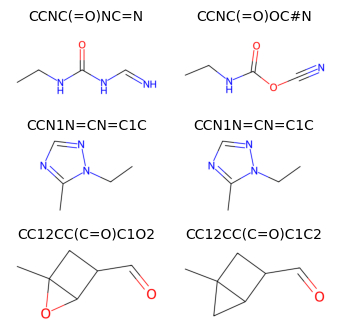

In [ ]:
fig, axes = plt.subplots(3, 2, figsize=(3.5, 3.5))

# Plot each molecule in its respective subplot
for i, ax in enumerate(axes[:,0]):
    if gt_molecules[i]:  # Ensure valid molecule
        img = Draw.MolToImage(gt_molecules[i], size=(400, 200))
        ax.imshow(img)
        ax.set_title(gt_mol[i], fontsize=10)
    ax.axis("off")

for i, ax in enumerate(axes[:,1]):
    if pr_molecules[i]:  # Ensure valid molecule
        img = Draw.MolToImage(pr_molecules[i], size=(400, 200))
        ax.imshow(img)
        ax.set_title(pred_mol[i], fontsize=10)
    ax.axis("off")

plt.tight_layout()

fig.savefig('molecules_examples_new.jpg', dpi=300, bbox_inches='tight')

## varius number of latent variables

In [47]:
lv = [7, 9, 11, 13, 15, 17, 19, 25]

In [51]:
rmse_vae_lv = {}
for lat_var in lv:
  print(f'Lat. var. {lat_var}')
  data_dim = mol_train.shape[-2:]


  torch_mol_train = mol_train.reshape(-1,data_dim[0]*data_dim[1]).to(dtype=torch.float32)
  torch_mol_test = mol_test.reshape(-1,data_dim[0]*data_dim[1]).to(dtype=torch.float32)

  model = dkiVAE(data_dim=data_dim, latent_dim=lat_var, dkl_scale_factor=1e-2,
                hidden_dim_d=[256],
                hidden_dim_e=[256],
                seed=40)

  dataloader = init_dataloader(torch_mol_train, tt(targets3_train).to(dtype=torch.float32), batch_size=512)
  trainer = JointModelTrainer(model, lr1=1e-3, seed=40)

  vae_accuracy = np.array([])
  dkl_rmse = np.array([])
  epoches = np.array([])

  for e in range(2000):
      #train_vae = 0 if e < 200 else 1  # we can start training VAE e.g. after 200 epochs
      trainer.step(dataloader, train_vae=True)
      trainer.print_statistics()
      if (e+1) % 50 == 0:
        test_mean_m, test_cov_m = model.dkl_predict(torch_mol_test);
        vae_pred = model.vae_predict(torch_mol_test)
        element_wise_comparison = (torch_mol_test.reshape(-1,*data_dim) == vae_pred)
        overall_accuracy = np.mean((element_wise_comparison.all(axis=(1,2))).numpy())

        vae_accuracy = np.append(vae_accuracy, overall_accuracy)
        dkl_rmse = np.append(dkl_rmse,
                            np.sqrt(np.mean((test_mean_m.numpy() - targets3_test) ** 2)))
        epoches = np.append(epoches, e)

  rmse_vae_lv[lat_var]= np.array([epoches, dkl_rmse, vae_accuracy,
                                     np.array(trainer.loss_history['vae_loss'])[epoches.astype(int)],
                                     np.array(trainer.loss_history['dkl_loss'])[epoches.astype(int)]])



Lat. var. 17
Epoch: 1 Training loss: 167045.4393 VAE loss: 270.7087 DKL loss: 166774.7307
Epoch: 2 Training loss: 74576.9880 VAE loss: 77.3749 DKL loss: 74499.6131
Epoch: 3 Training loss: 42545.7593 VAE loss: 55.9830 DKL loss: 42489.7763
Epoch: 4 Training loss: 27711.9311 VAE loss: 51.1347 DKL loss: 27660.7964
Epoch: 5 Training loss: 20990.3688 VAE loss: 49.1778 DKL loss: 20941.1911
Epoch: 6 Training loss: 19888.1693 VAE loss: 48.0938 DKL loss: 19840.0755
Epoch: 7 Training loss: 19241.3369 VAE loss: 47.3675 DKL loss: 19193.9694
Epoch: 8 Training loss: 17084.2329 VAE loss: 46.8464 DKL loss: 17037.3865
Epoch: 9 Training loss: 17132.5055 VAE loss: 46.4073 DKL loss: 17086.0983
Epoch: 10 Training loss: 14739.1136 VAE loss: 46.0322 DKL loss: 14693.0814
Epoch: 11 Training loss: 13236.8270 VAE loss: 45.9580 DKL loss: 13190.8690
Epoch: 12 Training loss: 10833.3485 VAE loss: 45.6452 DKL loss: 10787.7033
Epoch: 13 Training loss: 10224.8629 VAE loss: 45.4974 DKL loss: 10179.3655
Epoch: 14 Training

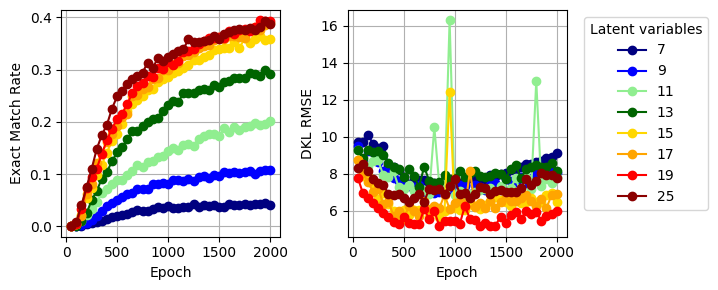

In [53]:
fig, ax = plt.subplots(1, 2, figsize=(7.3,3))
# ax[0].plot(rmse_vae_lv[5][0], rmse_vae_lv[5][2], 'o-', label='5', c='navy')
# ax[1].plot(rmse_vae_lv[5][0], rmse_vae_lv[5][1], 'o-', label='5', c='navy')

ax[0].plot(rmse_vae_lv[7][0], rmse_vae_lv[7][2], 'o-', label='7', c='navy')
ax[1].plot(rmse_vae_lv[7][0], rmse_vae_lv[7][1], 'o-', label='7', c='navy')

ax[0].plot(rmse_vae_lv[9][0], rmse_vae_lv[9][2], 'o-', label='9', c='blue')
ax[1].plot(rmse_vae_lv[9][0], rmse_vae_lv[9][1], 'o-', label='9', c='blue')

ax[0].plot(rmse_vae_lv[11][0], rmse_vae_lv[11][2], 'o-', label='11', c='lightgreen')
ax[1].plot(rmse_vae_lv[11][0], rmse_vae_lv[11][1], 'o-', label='11', c='lightgreen')

ax[0].plot(rmse_vae_lv[13][0], rmse_vae_lv[13][2], 'o-', label='13', c='darkgreen')
ax[1].plot(rmse_vae_lv[13][0], rmse_vae_lv[13][1], 'o-', label='13', c='darkgreen')

ax[0].plot(rmse_vae_lv[15][0], rmse_vae_lv[15][2], 'o-', label='15', c='gold')
ax[1].plot(rmse_vae_lv[15][0], rmse_vae_lv[15][1], 'o-', label='15', c='gold')

ax[0].plot(rmse_vae_lv[17][0], rmse_vae_lv[17][2], 'o-', label='17', c='orange')
ax[1].plot(rmse_vae_lv[17][0], rmse_vae_lv[17][1], 'o-', label='17', c='orange')

ax[0].plot(rmse_vae_lv[19][0], rmse_vae_lv[19][2], 'o-', label='19', c='r')
ax[1].plot(rmse_vae_lv[19][0], rmse_vae_lv[19][1], 'o-', label='19', c='r')

ax[0].plot(rmse_vae_lv[25][0], rmse_vae_lv[25][2], 'o-', label='25', c='darkred')
ax[1].plot(rmse_vae_lv[25][0], rmse_vae_lv[25][1], 'o-', label='25', c='darkred')

for _ in ax:
  _.set_xlabel('Epoch')
  _.grid()
  #_.set_xlim(0,1100)

ax[1].legend(title='Latent variables', loc='upper left', bbox_to_anchor=(1.05, 1))
ax[0].set_ylabel('Exact Match Rate')
ax[1].set_ylabel('DKL RMSE')

plt.tight_layout()

fig.savefig('fig_s4_new.jpg', dpi=300, bbox_inches='tight')

In [62]:
#np.savez("fig_s4_new.npz", **rmse_vae_lv)

TypeError: keywords must be strings

## various hidden layers

In [30]:
hl = [[128], [256], [512], [1024], [1024, 1024]]
hl_k = ['128', '256', '512', '1024', '1024, 1024']

In [39]:
rmse_vae_hl = {}
for i, hid_l in enumerate(hl):
  print(f'Lat. var. {hid_l}')
  data_dim = mol_train.shape[-2:]


  torch_mol_train = mol_train.reshape(-1,data_dim[0]*data_dim[1]).to(dtype=torch.float32)
  torch_mol_test = mol_test.reshape(-1,data_dim[0]*data_dim[1]).to(dtype=torch.float32)

  model = dkiVAE(data_dim=data_dim, latent_dim=17, dkl_scale_factor=1e-2,
                hidden_dim_d=hid_l,
                hidden_dim_e=hid_l,
                seed=40)

  dataloader = init_dataloader(torch_mol_train, tt(targets3_train).to(dtype=torch.float32), batch_size=512)
  trainer = JointModelTrainer(model, lr1=1e-3, seed=40)

  vae_accuracy = np.array([])
  dkl_rmse = np.array([])
  epoches = np.array([])

  for e in range(2000):
      #train_vae = 0 if e < 200 else 1  # we can start training VAE e.g. after 200 epochs
      trainer.step(dataloader, train_vae=True)
      trainer.print_statistics()
      if (e+1) % 50 == 0:
        test_mean_m, test_cov_m = model.dkl_predict(torch_mol_test);
        vae_pred = model.vae_predict(torch_mol_test)
        element_wise_comparison = (torch_mol_test.reshape(-1,*data_dim) == vae_pred)
        overall_accuracy = np.mean((element_wise_comparison.all(axis=(1,2))).numpy())

        vae_accuracy = np.append(vae_accuracy, overall_accuracy)
        dkl_rmse = np.append(dkl_rmse,
                            np.sqrt(np.mean((test_mean_m.numpy() - targets3_test) ** 2)))
        epoches = np.append(epoches, e)

  rmse_vae_hl[hl_k[i]]= np.array([epoches, dkl_rmse, vae_accuracy,
                                     np.array(trainer.loss_history['vae_loss'])[epoches.astype(int)],
                                     np.array(trainer.loss_history['dkl_loss'])[epoches.astype(int)]])



Lat. var. [1024, 1024]
Epoch: 1 Training loss: 169206.6498 VAE loss: 110.3566 DKL loss: 169096.2932
Epoch: 2 Training loss: 61325.4850 VAE loss: 44.8993 DKL loss: 61280.5857
Epoch: 3 Training loss: 35703.5414 VAE loss: 43.4216 DKL loss: 35660.1198
Epoch: 4 Training loss: 21270.4430 VAE loss: 41.8522 DKL loss: 21228.5908
Epoch: 5 Training loss: 17499.1900 VAE loss: 40.6366 DKL loss: 17458.5534
Epoch: 6 Training loss: 12696.9492 VAE loss: 39.5187 DKL loss: 12657.4305
Epoch: 7 Training loss: 10731.6793 VAE loss: 38.3437 DKL loss: 10693.3356
Epoch: 8 Training loss: 11235.3906 VAE loss: 37.4052 DKL loss: 11197.9854
Epoch: 9 Training loss: 10529.0696 VAE loss: 36.8205 DKL loss: 10492.2492
Epoch: 10 Training loss: 8134.0515 VAE loss: 36.3157 DKL loss: 8097.7358
Epoch: 11 Training loss: 8056.9594 VAE loss: 35.8095 DKL loss: 8021.1500
Epoch: 12 Training loss: 7740.5346 VAE loss: 35.2173 DKL loss: 7705.3172
Epoch: 13 Training loss: 8696.2172 VAE loss: 34.6801 DKL loss: 8661.5371
Epoch: 14 Traini

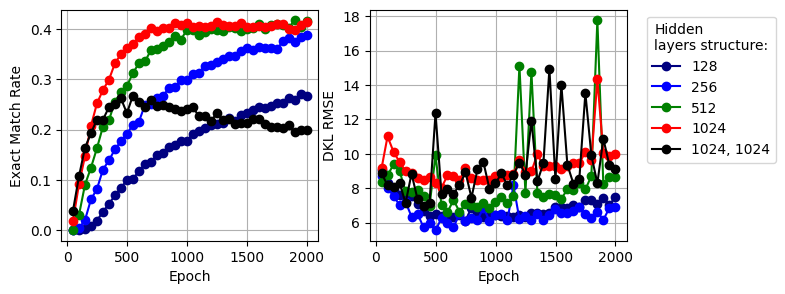

In [61]:
fig, ax = plt.subplots(1, 2, figsize=(7.3,3))

ax[0].plot(rmse_vae_hl['128'][0], rmse_vae_hl['128'][2], 'o-', label='128', c='navy')
ax[1].plot(rmse_vae_hl['128'][0], rmse_vae_hl['128'][1], 'o-', label='128', c='navy')

ax[0].plot(rmse_vae_hl['256'][0], rmse_vae_hl['256'][2], 'o-', label='256', c='b')
ax[1].plot(rmse_vae_hl['256'][0], rmse_vae_hl['256'][1], 'o-', label='256', c='b')

ax[0].plot(rmse_vae_hl['512'][0], rmse_vae_hl['512'][2], 'o-', label='512', c='g')
ax[1].plot(rmse_vae_hl['512'][0], rmse_vae_hl['512'][1], 'o-', label='512', c='g')

ax[0].plot(rmse_vae_hl['1024'][0], rmse_vae_hl['1024'][2], 'o-', label='1024', c='r')
ax[1].plot(rmse_vae_hl['1024'][0], rmse_vae_hl['1024'][1], 'o-', label='1024', c='r')

ax[0].plot(rmse_vae_hl['1024_1024'][0], rmse_vae_hl['1024_1024'][2], 'o-', label='1024, 1024', c='black')
ax[1].plot(rmse_vae_hl['1024_1024'][0], rmse_vae_hl['1024_1024'][1], 'o-', label='1024, 1024', c='black')

# ax[0].plot(rmse_vae_hl['128_128'][0], rmse_vae_hl['128_128'][2], 'o-', label='128, 128', c='grey')
# ax[1].plot(rmse_vae_hl['128_128'][0], rmse_vae_hl['128_128'][1], 'o-', label='128, 128', c='grey')

for _ in ax:
  _.set_xlabel('Epoch')
  _.grid()
  #_.set_xlim(0,2000)

ax[1].legend(title=f'Hidden\nlayers structure:', loc='upper left', bbox_to_anchor=(1.05, 1))
ax[0].set_ylabel('Exact Match Rate')
ax[1].set_ylabel('DKL RMSE')

fig.savefig('fig_s5_new.jpg', dpi=300, bbox_inches='tight')

In [46]:
np.savez("fig_s5_new.npz", **rmse_vae_hl)